In [1]:
!pip install -q git+https://github.com/huggingface/transformers.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [8]:
import numpy as np
import matplotlib.pyplot as plt
import gc

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30 / 255, 144 / 255, 255 / 255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    del mask
    gc.collect()

def show_masks_on_image(raw_image, masks):
  plt.imshow(np.array(raw_image))
  ax = plt.gca()
  ax.set_autoscale_on(False)
  for mask in masks:
      show_mask(mask, ax=ax, random_color=True)
  plt.axis("off")
  plt.show()
  del mask
  gc.collect()

In [1]:
from transformers import pipeline
generator = pipeline("mask-generation", model="facebook/sam-vit-huge", device=0)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.56G [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

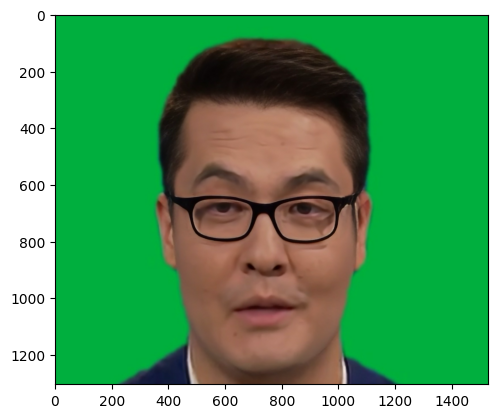

In [5]:
from PIL import Image
import requests
import matplotlib.pyplot as plt

# img_url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/transformers/tasks/car.jpg"
# raw_image = Image.open(requests.get(img_url, stream=True).raw).convert("RGB")
raw_image = Image.open("human.png")
plt.imshow(raw_image)

In [6]:
outputs = generator(raw_image, points_per_batch=64)

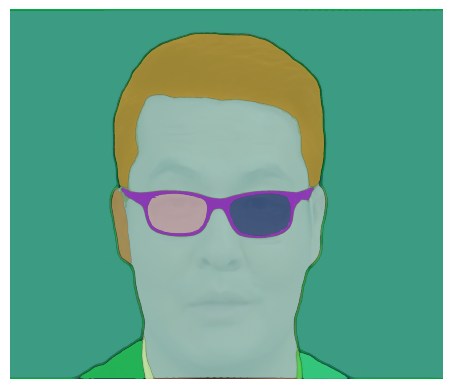

In [9]:
masks = outputs["masks"]
show_masks_on_image(raw_image, masks)


In [42]:
# a = [np.sum(i[200:400,600:800]) for i in masks]
a

array([False, False])

In [43]:
# plt.imshow(masks[1])

12
[66436, 117138, 19127, 8284, 19615, 1929, 10557, 8498, 1193, 3112, 2822, 2930]
0


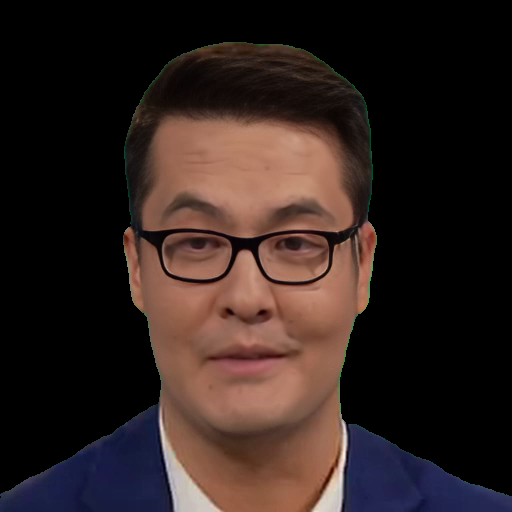

12
[66132, 115411, 8227, 17940, 19638, 1766, 9958, 7909, 1093, 2795, 2858, 2913]
0


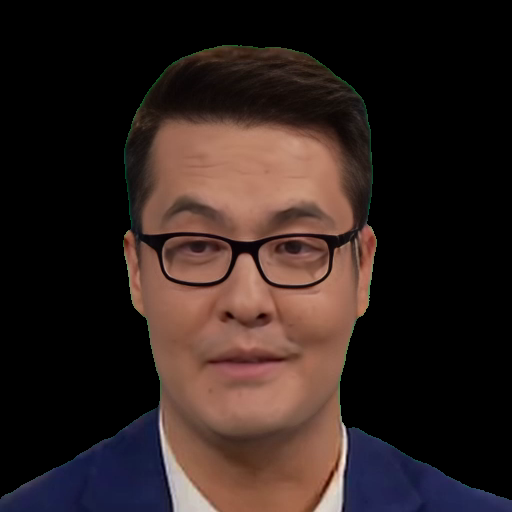

13
[143494, 66087, 8253, 17992, 19596, 1788, 9952, 7963, 1108, 2780, 2883, 2923, 2912]
0


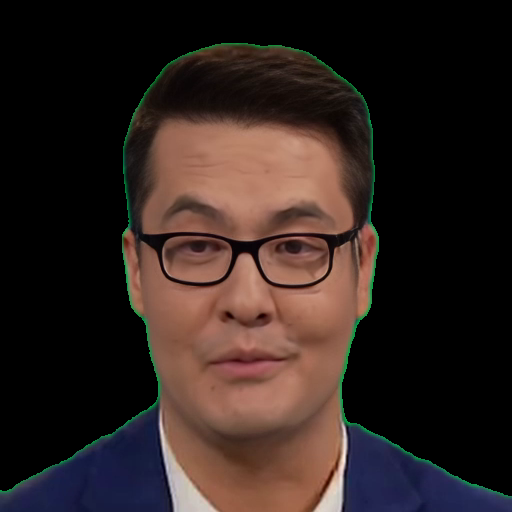

13
[143492, 66186, 8285, 17937, 19559, 1800, 9949, 7933, 1106, 2892, 2785, 2945, 2940]
0


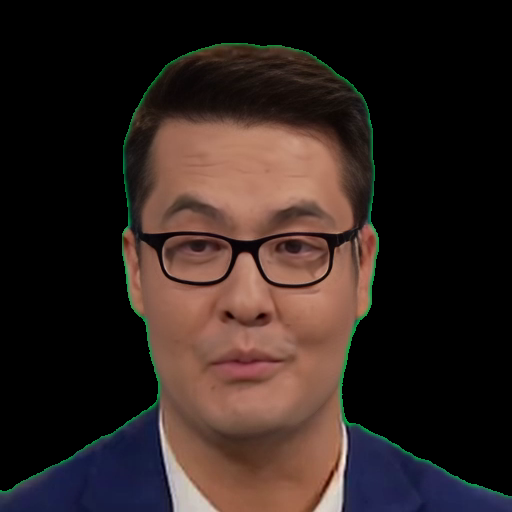

12
[143577, 66201, 8289, 17946, 19454, 1785, 9962, 7899, 1101, 2874, 2792, 2970]
0


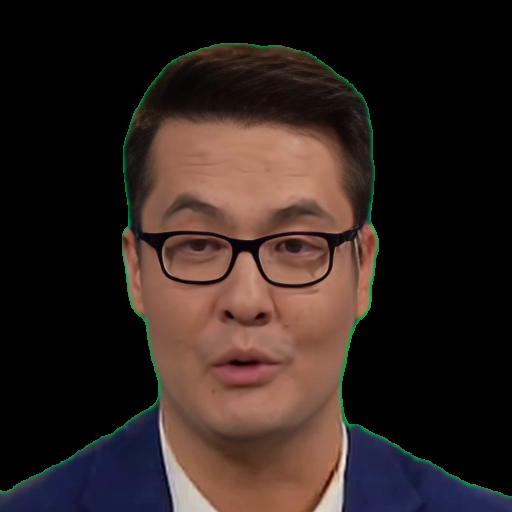

13
[66174, 115314, 8321, 17893, 19407, 1746, 9940, 7853, 1082, 2815, 2819, 2983, 2972]
0


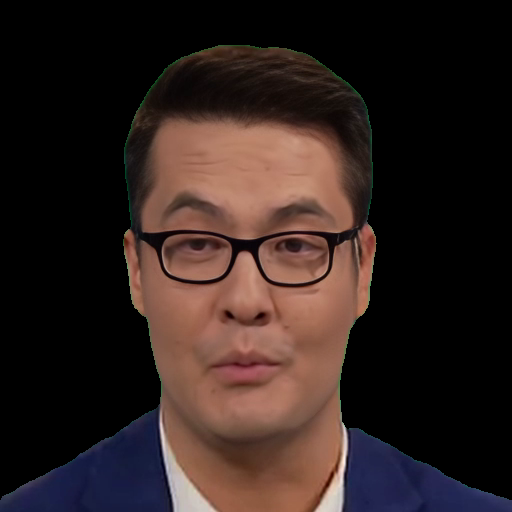

13
[66541, 115247, 8346, 17763, 19392, 9907, 1742, 1079, 7810, 2820, 2819, 3002, 2992]
0


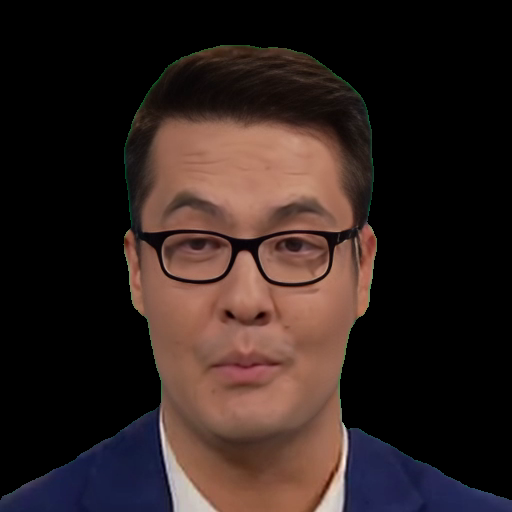

13
[66174, 115126, 8344, 17734, 19353, 9922, 1776, 1112, 7765, 2833, 2889, 3004, 2984]
0


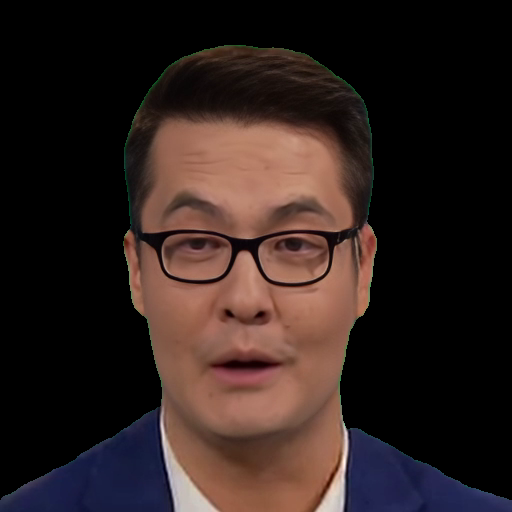

13
[66349, 114920, 8330, 17692, 19365, 9890, 1761, 7754, 1096, 2862, 2824, 2991, 1132]
0


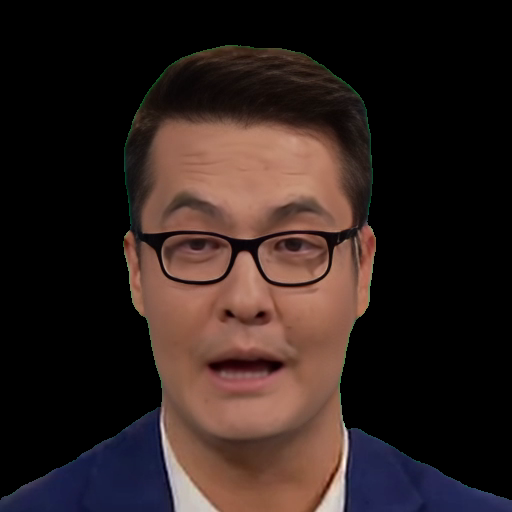

13
[66191, 114624, 8363, 17480, 19321, 9718, 1717, 1049, 7712, 2831, 2770, 2968, 2957]
0


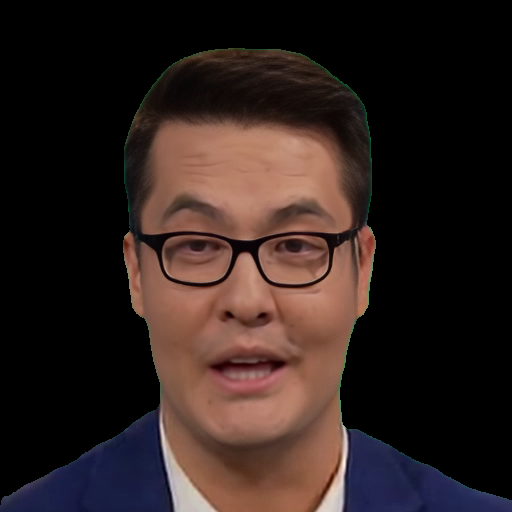

13
[66272, 115422, 8391, 18033, 19343, 1770, 9935, 8033, 1059, 2814, 2882, 2952, 366]
0


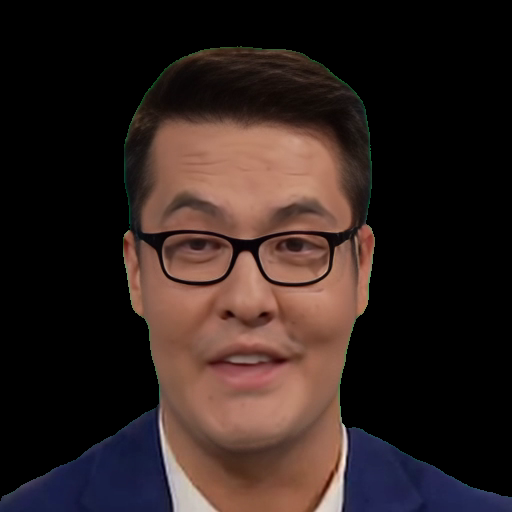

13
[66394, 115762, 8365, 18089, 19396, 1828, 9901, 8141, 1070, 2893, 2912, 2954, 364]
0


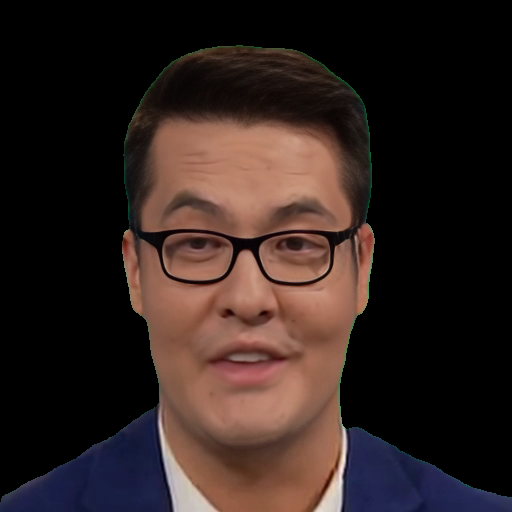

12
[66812, 115598, 8330, 18000, 19299, 1806, 9874, 8055, 1074, 2895, 2865, 2926]
0


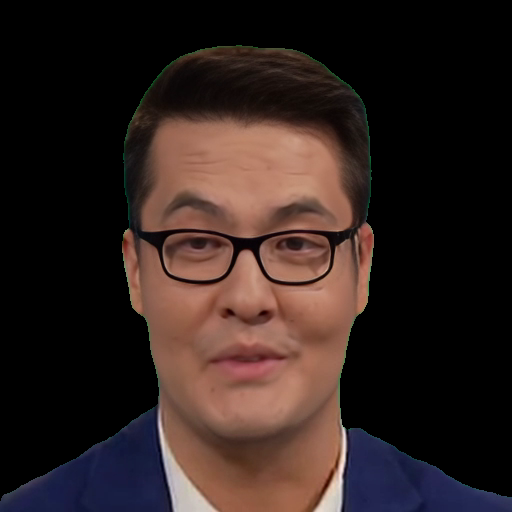

12
[66866, 115552, 8319, 17993, 19214, 1808, 9858, 8059, 1099, 2869, 2885, 2898]
0


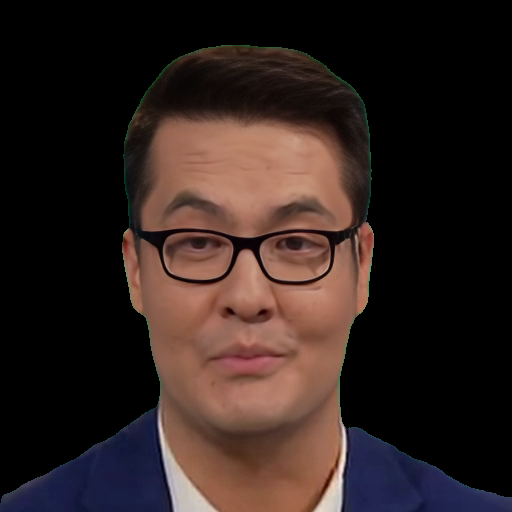

12
[66450, 115237, 8357, 17758, 19221, 9750, 1805, 7947, 1100, 2868, 2889, 2932]
0


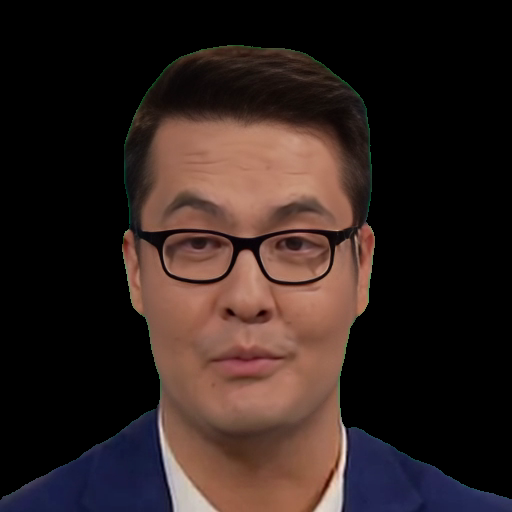

12
[66396, 115016, 8342, 17585, 19205, 9730, 1744, 7797, 1076, 2835, 2820, 2960]
0


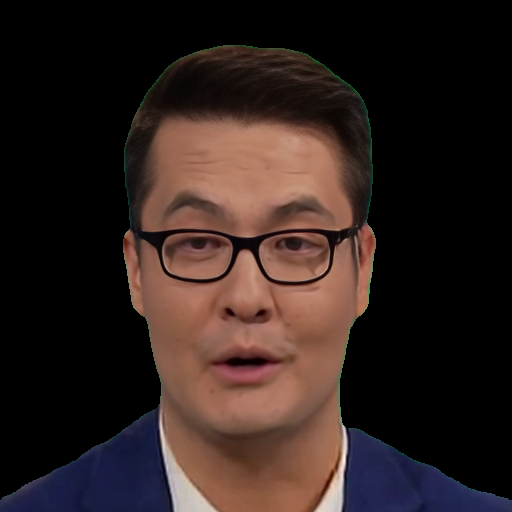

12
[66350, 114923, 8366, 17629, 19071, 9752, 1762, 7804, 1077, 2832, 2818, 2979]
0


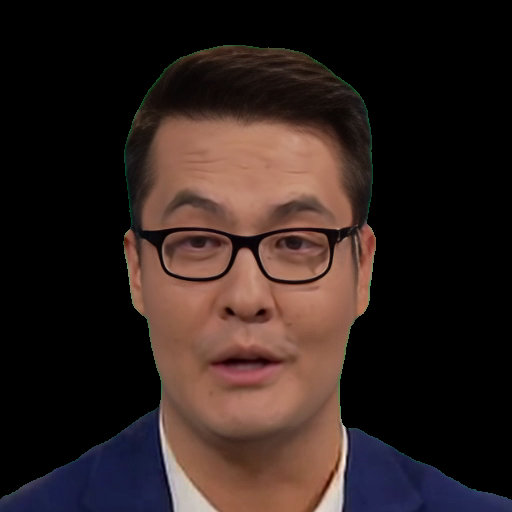

12
[66850, 114958, 8399, 17599, 18904, 9662, 1746, 7861, 1070, 2813, 2832, 2999]
0


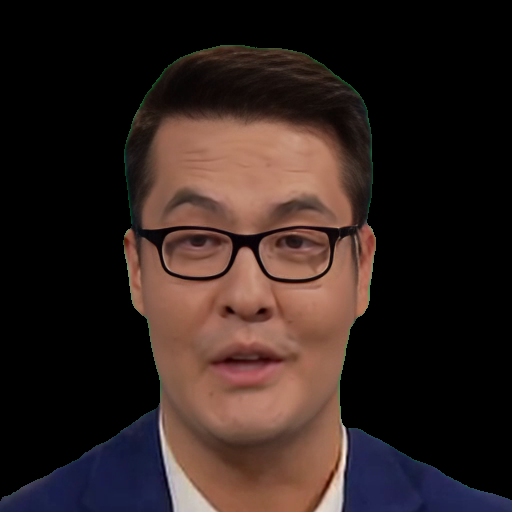

13
[66918, 114877, 8454, 17488, 18904, 9578, 1736, 7834, 1053, 2781, 2858, 3021, 296]
0


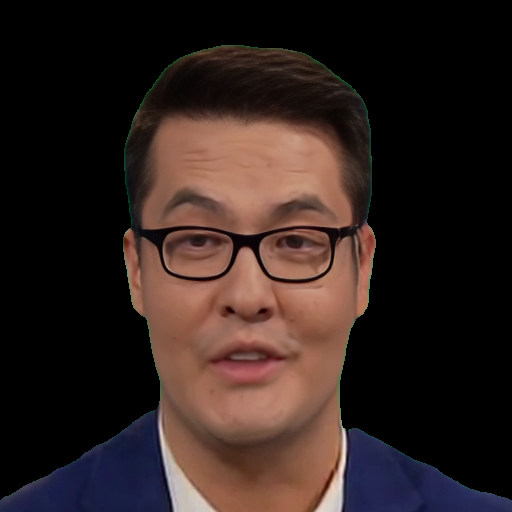

13
[114759, 66746, 8424, 17316, 18976, 9497, 1726, 7744, 1030, 2747, 2845, 2993, 363]
0


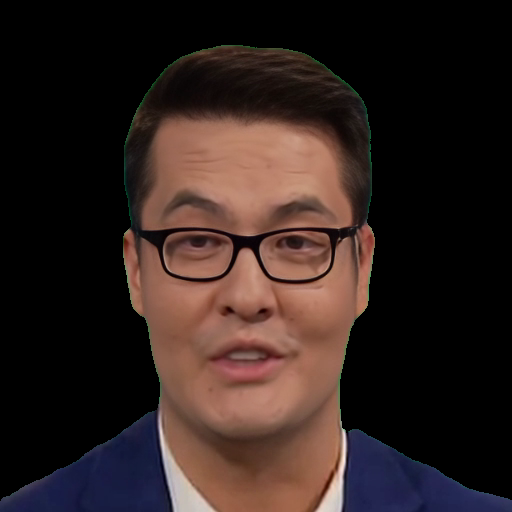

13
[66709, 114723, 8373, 17261, 19073, 9481, 1712, 1010, 7709, 2846, 2711, 2938, 1034]
0


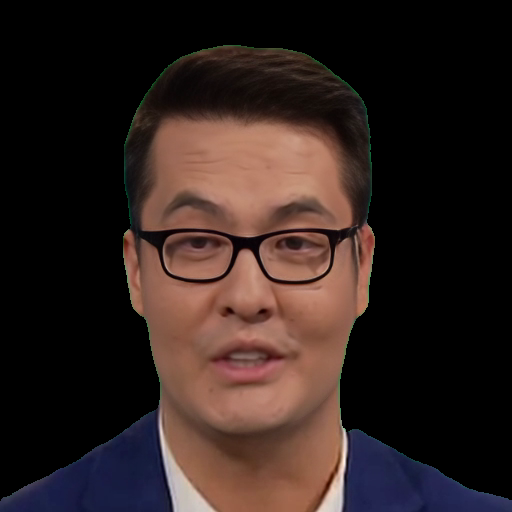

12
[114649, 66982, 8304, 17193, 19146, 9473, 1691, 1010, 7671, 2842, 2705, 2926]
0


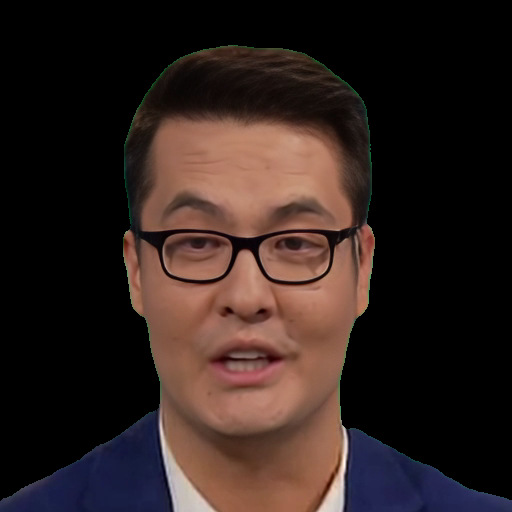

13
[114693, 66976, 8322, 17235, 19191, 9505, 1673, 1010, 7685, 2683, 2848, 66640, 2964]
0


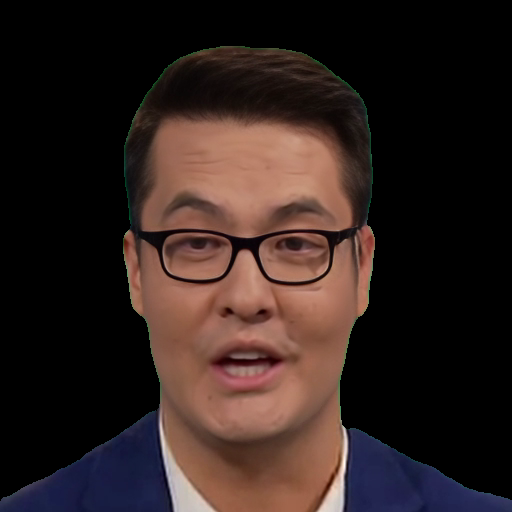

12
[114772, 66728, 8349, 17322, 19229, 1689, 9502, 1020, 7726, 2857, 2704, 2966]
0


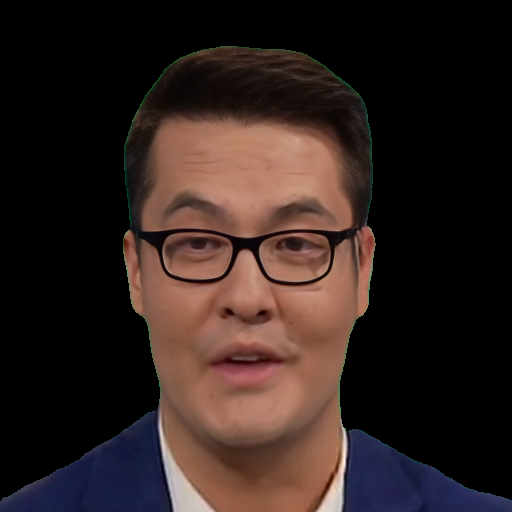

12
[114868, 66778, 8338, 17450, 19261, 1688, 9608, 7779, 1014, 2837, 2692, 2943]
0


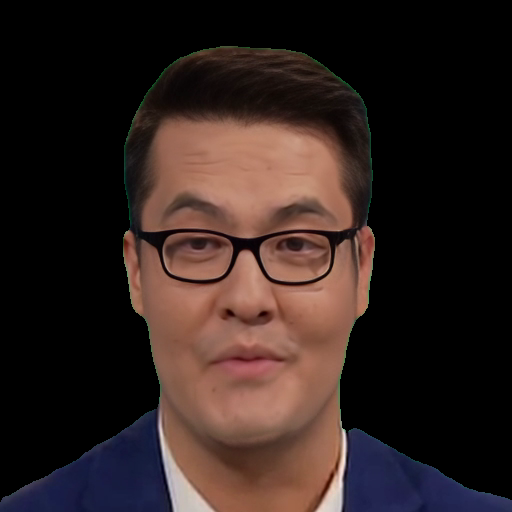

12
[114806, 66521, 8303, 17507, 19257, 1733, 9644, 7797, 1051, 2845, 2773, 2950]
0


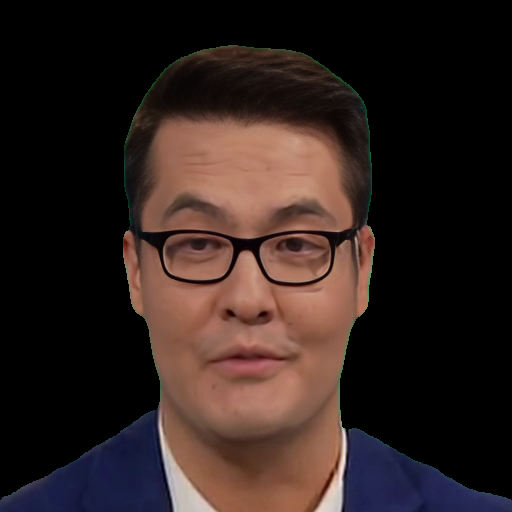

13
[66259, 115051, 8325, 17655, 19384, 9780, 1771, 7828, 1072, 2831, 2844, 2962, 2964]
0


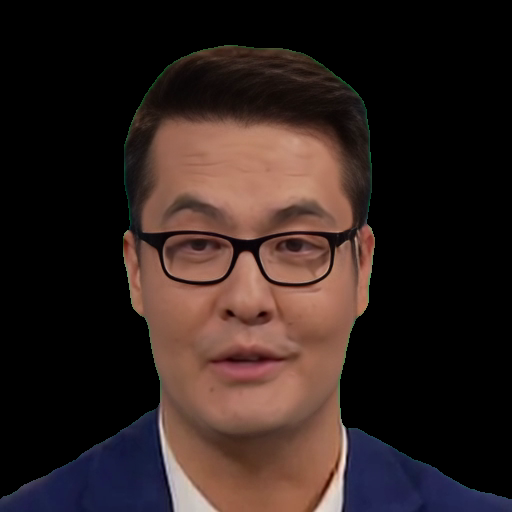

12
[66154, 115260, 17813, 8292, 19542, 9867, 1785, 1078, 7887, 2852, 2824, 2901]
0


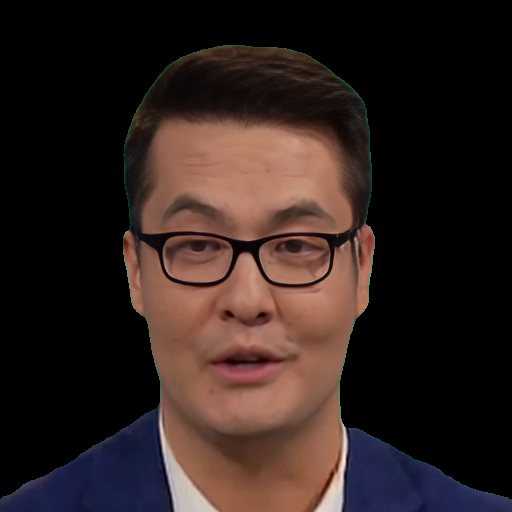

12
[66115, 115035, 17602, 8290, 19654, 9728, 1719, 7809, 1044, 2828, 2743, 2899]
0


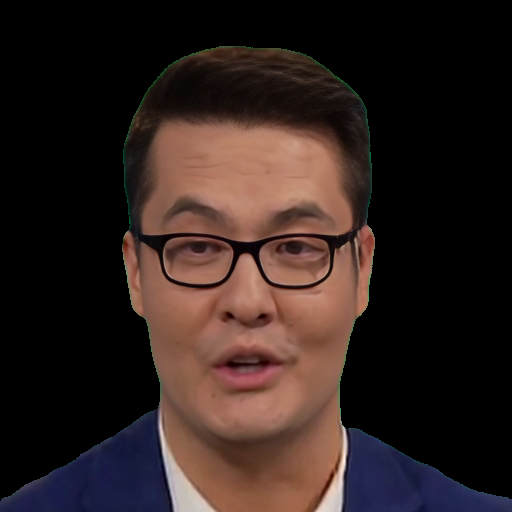

12
[115161, 66136, 8324, 17650, 19727, 1730, 9720, 7866, 1059, 2770, 2842, 2947]
0


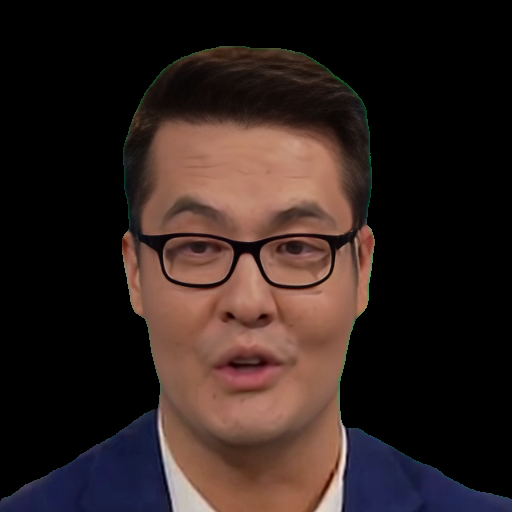

13
[115262, 66401, 8369, 17706, 19660, 1732, 9715, 7911, 1049, 2755, 2880, 2986, 2975]
0


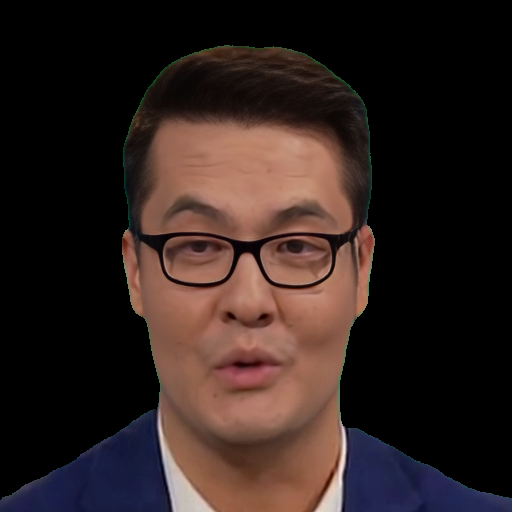

12
[115270, 66668, 8386, 17733, 19522, 1759, 9710, 7945, 1054, 2796, 2858, 3030]
0


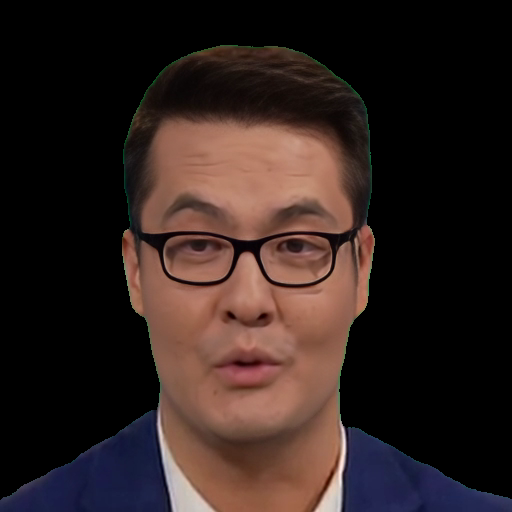

12
[66589, 114763, 8371, 17469, 19415, 1729, 9614, 7803, 1047, 2756, 2847, 3049]
0


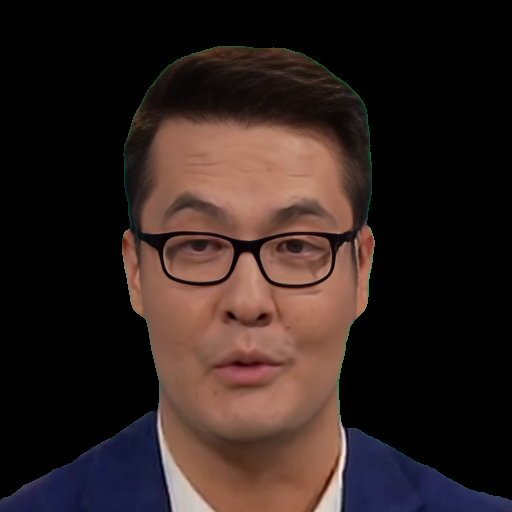

12
[66442, 114729, 8390, 17608, 19397, 9635, 1741, 7886, 1051, 2774, 2859, 3047]
0


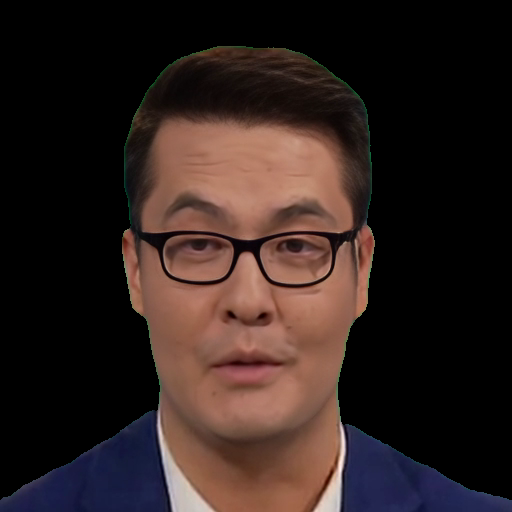

12
[114708, 66374, 8355, 17640, 19353, 1776, 9622, 7936, 1064, 2810, 2855, 3025]
0


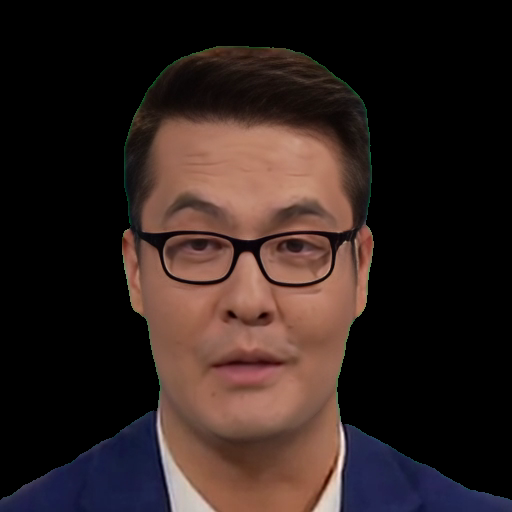

12
[114520, 66355, 8333, 17470, 19390, 1755, 9451, 7948, 1011, 2858, 2782, 3036]
0


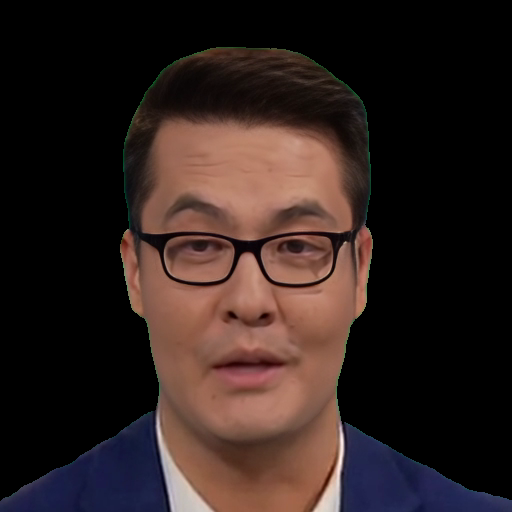

12
[114672, 66348, 8337, 17479, 19406, 1749, 9397, 8006, 1024, 2857, 2993, 2787]
0


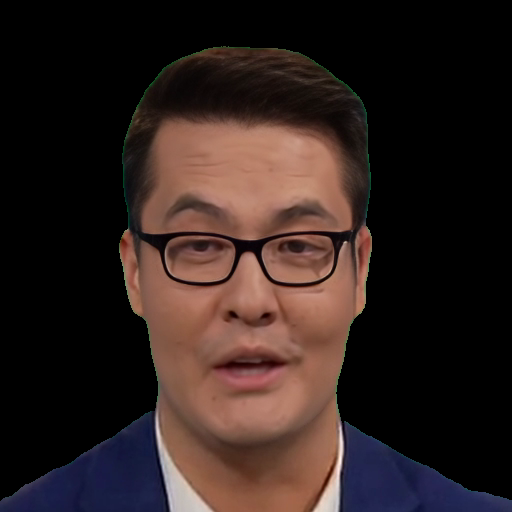

12
[115159, 66644, 8385, 17663, 19396, 1754, 9439, 8144, 1016, 2830, 2978, 2799]
0


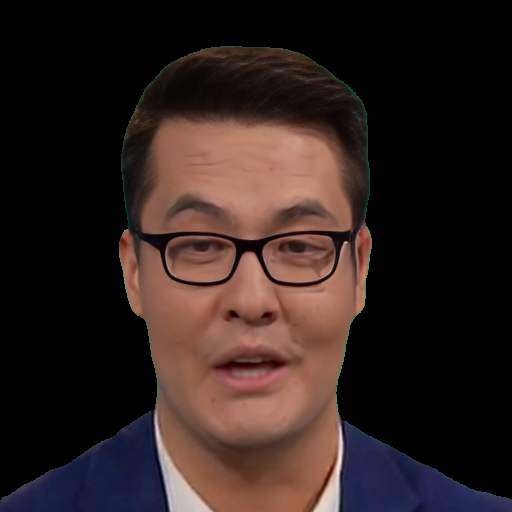

12
[114721, 66623, 8431, 17334, 19321, 1710, 9240, 7997, 982, 2965, 2875, 2757]
0


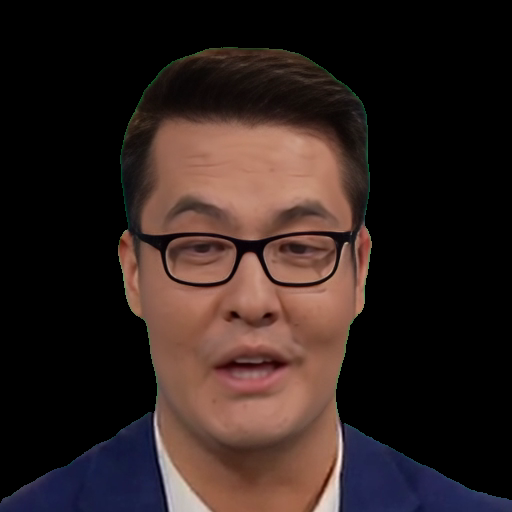

12
[66645, 114547, 8415, 17179, 19368, 1710, 9206, 7891, 996, 2884, 2974, 2752]
0


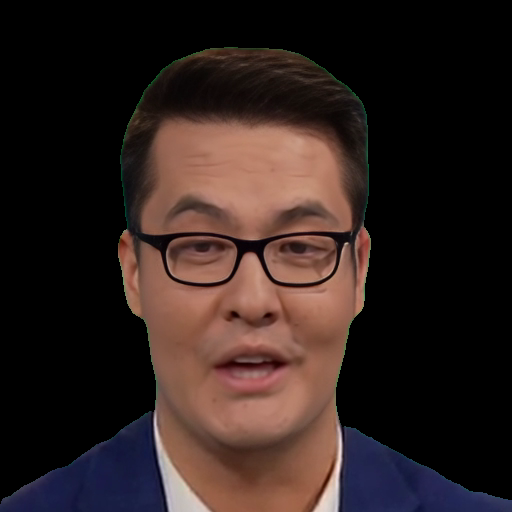

12
[66579, 114047, 8417, 16889, 19309, 1690, 9068, 7740, 974, 2863, 2989, 2698]
0


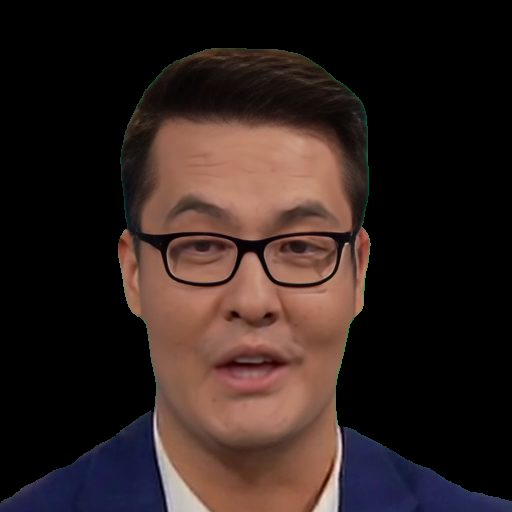

13
[66509, 114448, 8425, 17216, 19309, 1739, 9220, 7894, 1016, 2862, 3020, 1333, 2770]
0


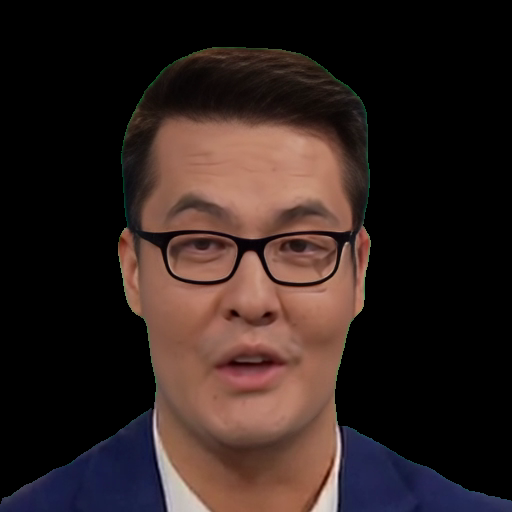

13
[66331, 114280, 8411, 17154, 19341, 9209, 1752, 7863, 1021, 2870, 1346, 2803, 3098]
0


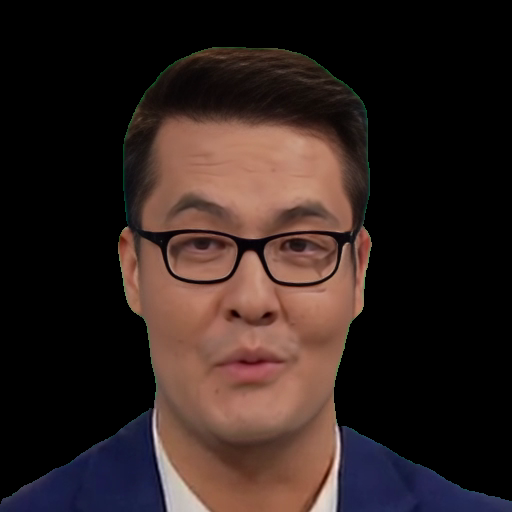

13
[66237, 114634, 8452, 17434, 19416, 1788, 9357, 7985, 1064, 3035, 2904, 2885, 1315]
0


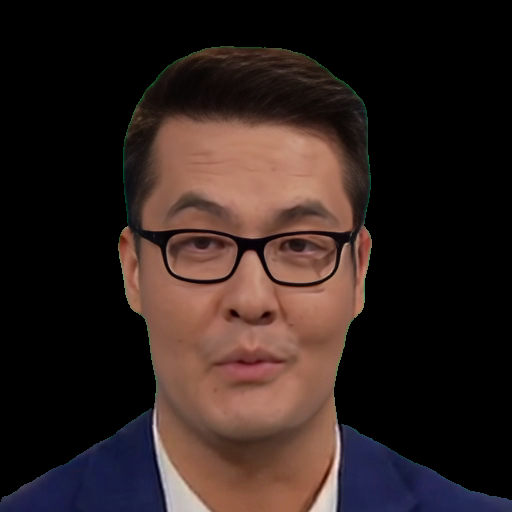

13
[66221, 114334, 8466, 17251, 19405, 1750, 9350, 7829, 1042, 1280, 2886, 2822, 3035]
0


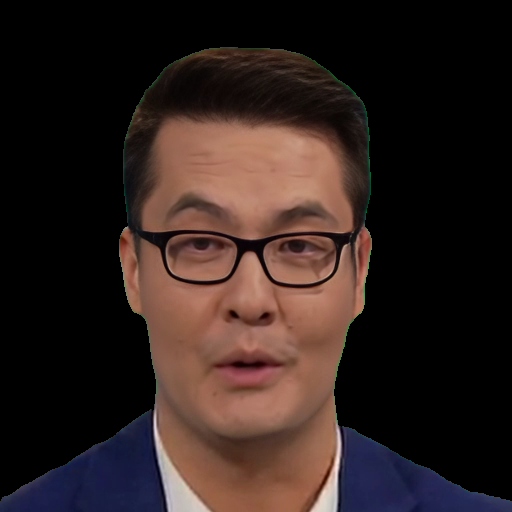

12
[66228, 114503, 8500, 17251, 19468, 1737, 9376, 7807, 2909, 2828, 1026, 3077]
0


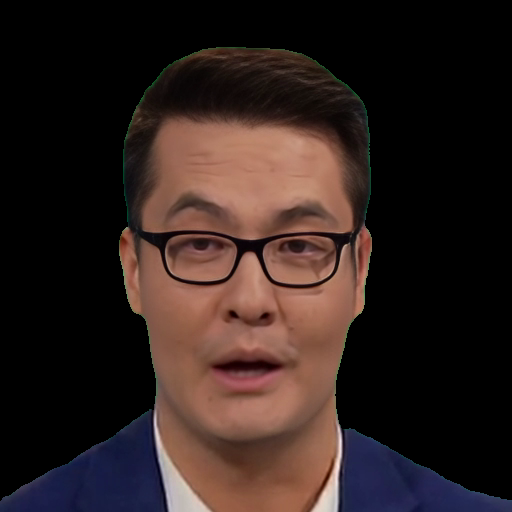

12
[114757, 66279, 8510, 17431, 19500, 1751, 9416, 7941, 1019, 2907, 3070, 2842]
0


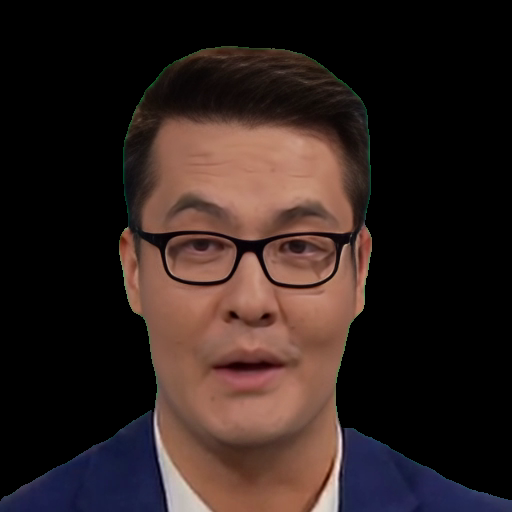

12
[66222, 115223, 8508, 17795, 19622, 1768, 9572, 8133, 1040, 2885, 3056, 2837]
0


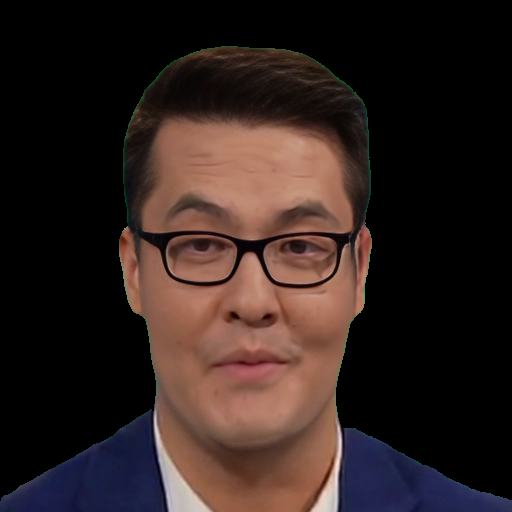

12
[115588, 66190, 8469, 18117, 19640, 1819, 9746, 8283, 1084, 2906, 2925, 3100]
0


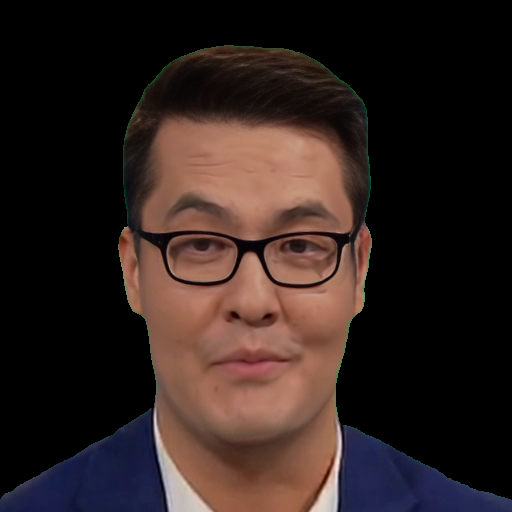

13
[66070, 114937, 8406, 17783, 19645, 1787, 9586, 8118, 1060, 1279, 2905, 3010, 2897]
0


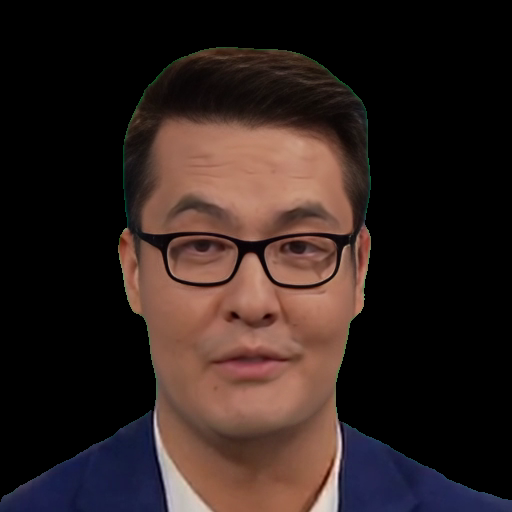

14
[66137, 115002, 8436, 17630, 19731, 1820, 9498, 8039, 1282, 1051, 2908, 3012, 2901, 8573]
0


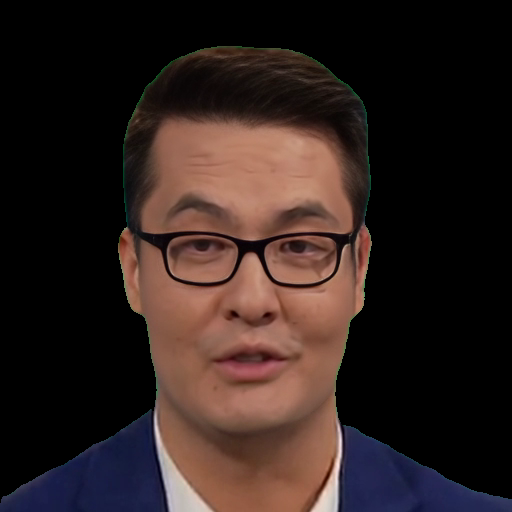

13
[66264, 114556, 8397, 17191, 19700, 1749, 9254, 7833, 1009, 1299, 2885, 3018, 2814]
0


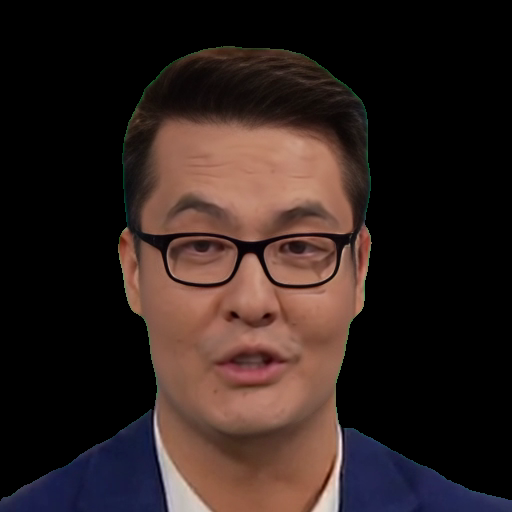

12
[114311, 66300, 8469, 16893, 19706, 1688, 9146, 7654, 966, 2897, 2686, 3104]
0


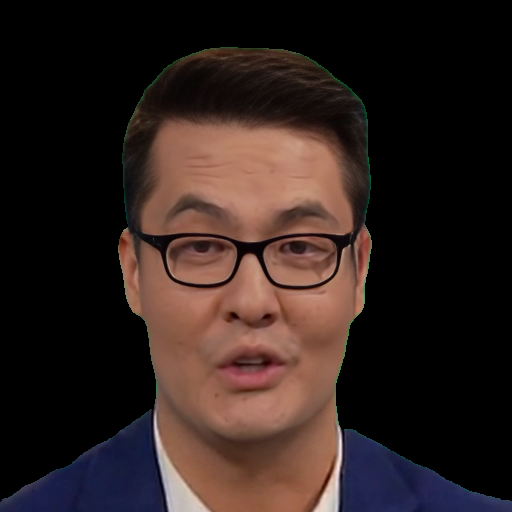

12
[66433, 114154, 8515, 16765, 19705, 1666, 9074, 7628, 958, 2903, 2644, 3142]
0


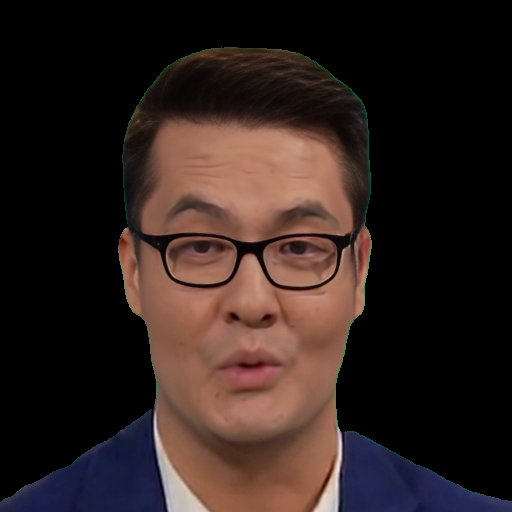

13
[66313, 114037, 8500, 16730, 19611, 1662, 9098, 7566, 950, 2908, 3082, 2639, 1286]
0


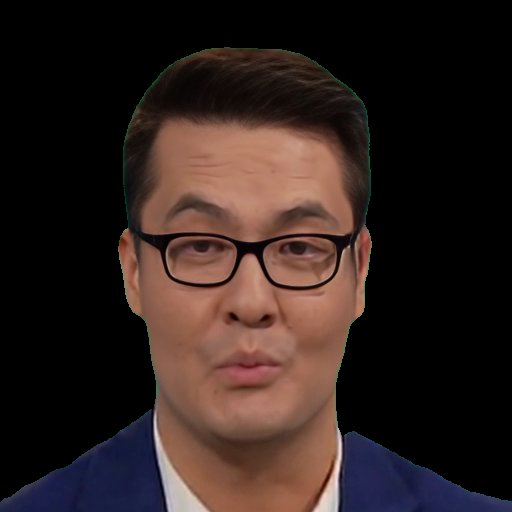

13
[66386, 113946, 8476, 16726, 19494, 1676, 9120, 7550, 945, 2869, 3082, 2652, 1296]
0


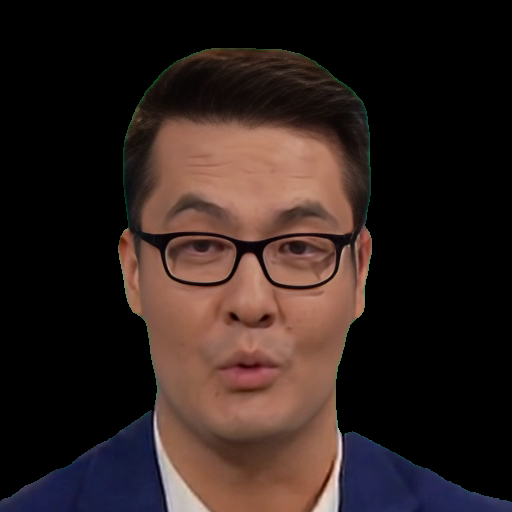

12
[66409, 113813, 8426, 16746, 19342, 1664, 9137, 7529, 959, 3038, 2886, 2689]
0


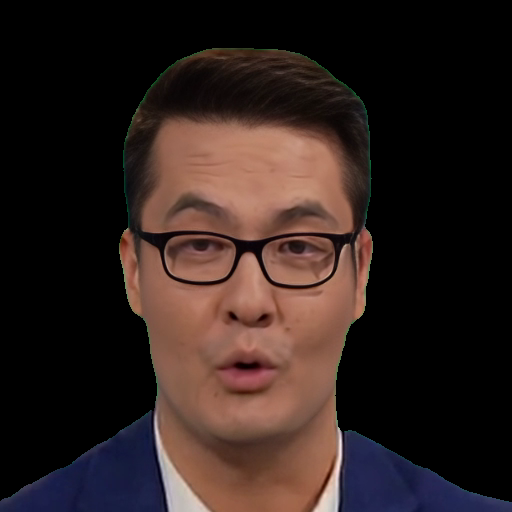

13
[66641, 114315, 8427, 17164, 19219, 1691, 9339, 7730, 978, 2869, 1198, 2703, 3061]
0


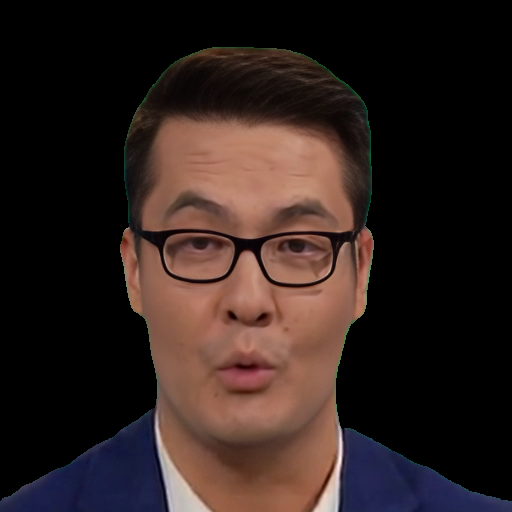

14
[66766, 114295, 8455, 17175, 19142, 1668, 9346, 7733, 972, 1157, 2859, 3067, 2686, 8642]
0


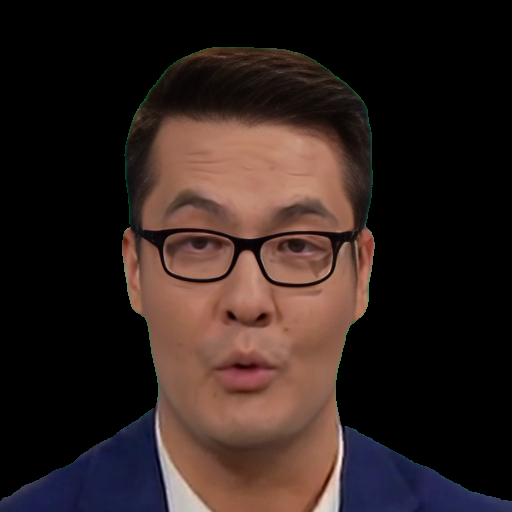

14
[66534, 114286, 8437, 17076, 19258, 1674, 9271, 7704, 957, 1185, 2863, 2687, 3085, 8648]
0


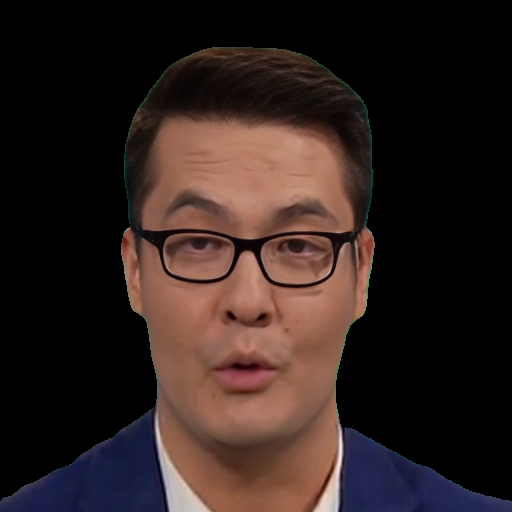

13
[66489, 114121, 8442, 16937, 19408, 1688, 9207, 7631, 967, 2881, 3055, 2703, 8639]
0


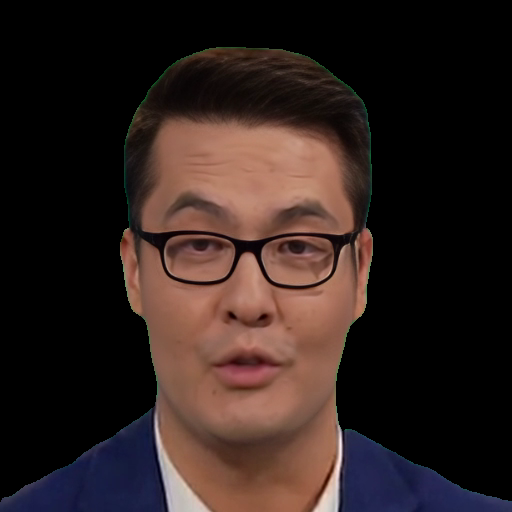

12
[66375, 114585, 8394, 17224, 19671, 1719, 9314, 7802, 988, 2867, 2758, 3025]
0


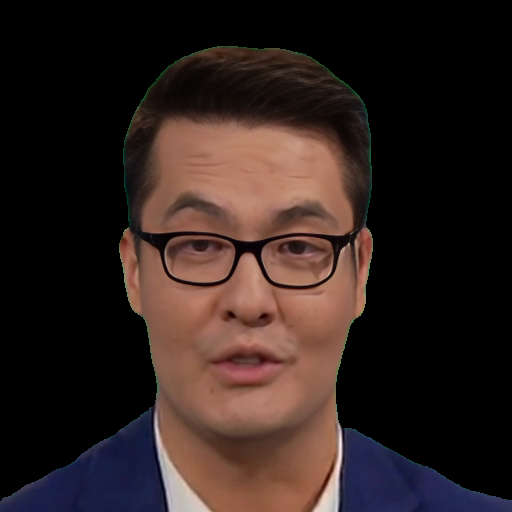

13
[66396, 114913, 8401, 17472, 19682, 1762, 9390, 7976, 996, 2869, 3000, 2796, 565]
0


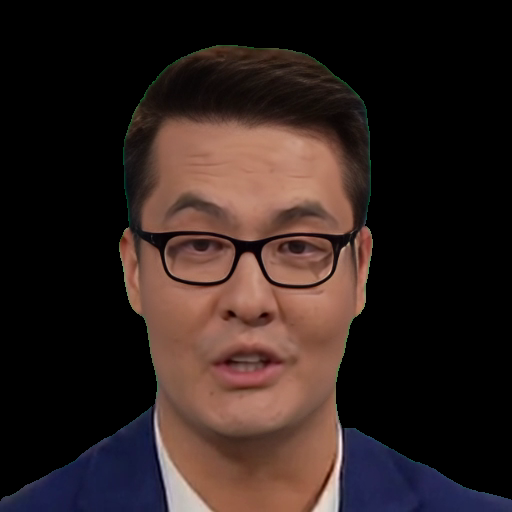

12
[66494, 115136, 8401, 17547, 19702, 1756, 9473, 7975, 1001, 2890, 2788, 3031]
0


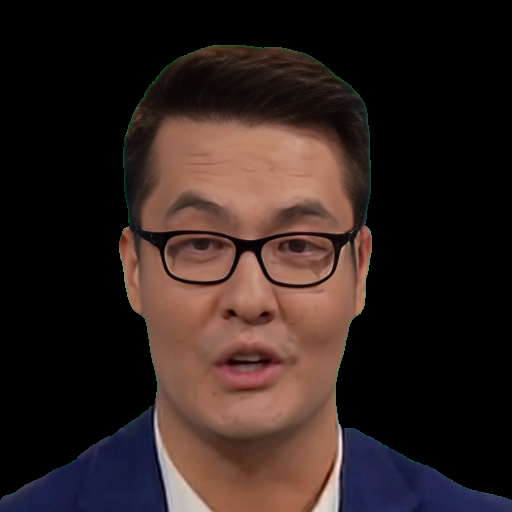

13
[66613, 114678, 8491, 17196, 19503, 1751, 9286, 7827, 983, 2888, 2785, 3070, 1277]
0


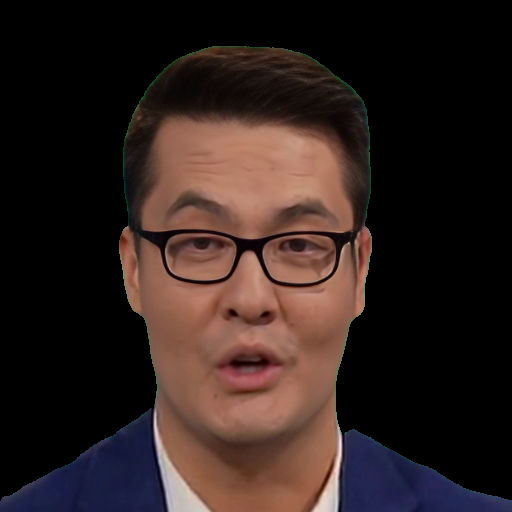

13
[66440, 114447, 8528, 17125, 19348, 9207, 1716, 7831, 999, 2908, 3073, 1315, 2744]
0


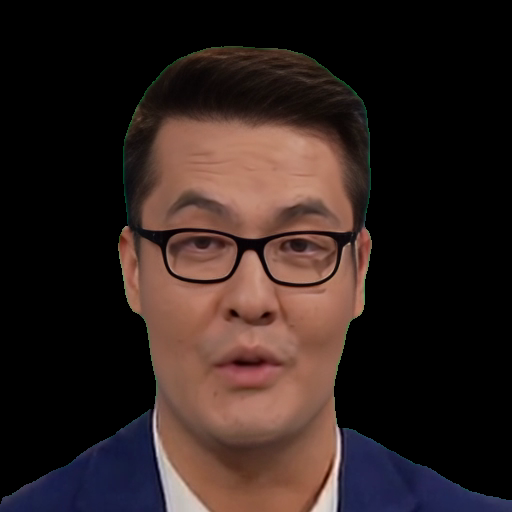

13
[66389, 114578, 8519, 17406, 19256, 9327, 7985, 1755, 1042, 2909, 3046, 2814, 1322]
0


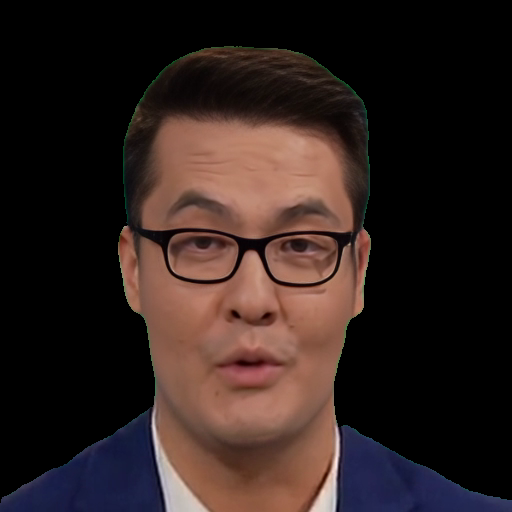

12
[143389, 66068, 8469, 18166, 19513, 9800, 1804, 8282, 1092, 2883, 2946, 3061]
0


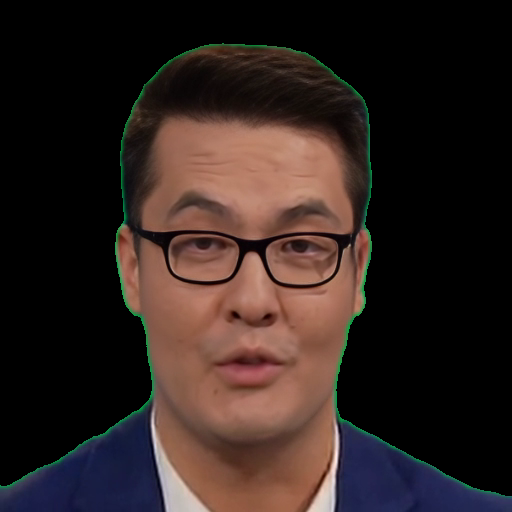

13
[65714, 142939, 8401, 18581, 20126, 10018, 1829, 8467, 1109, 2843, 2992, 1366, 3081]
0


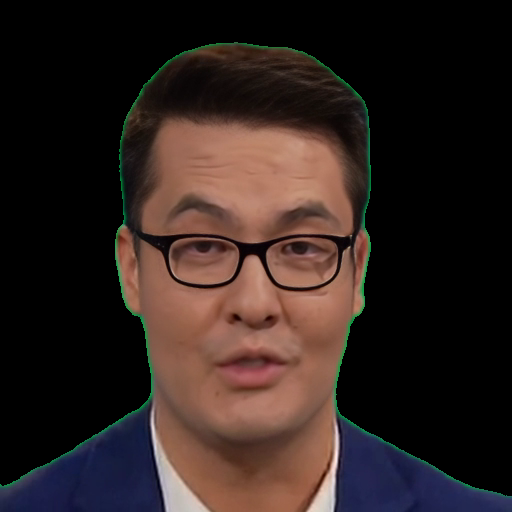

13
[65392, 116059, 18329, 8391, 20756, 9869, 8366, 1735, 1049, 1355, 2848, 2838, 3058]
0


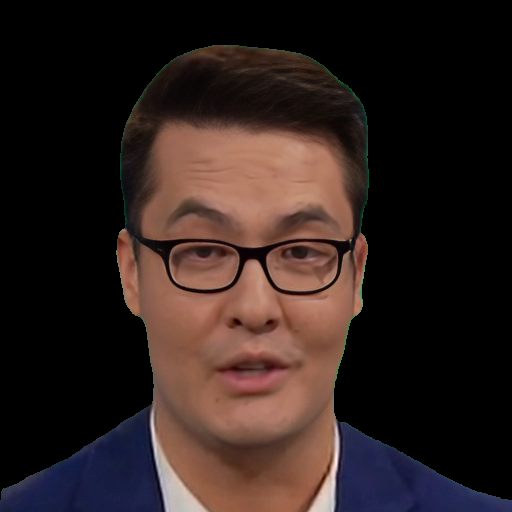

13
[65097, 115781, 17944, 8356, 21315, 9621, 1660, 8224, 1009, 1355, 2845, 2718, 2992]
0


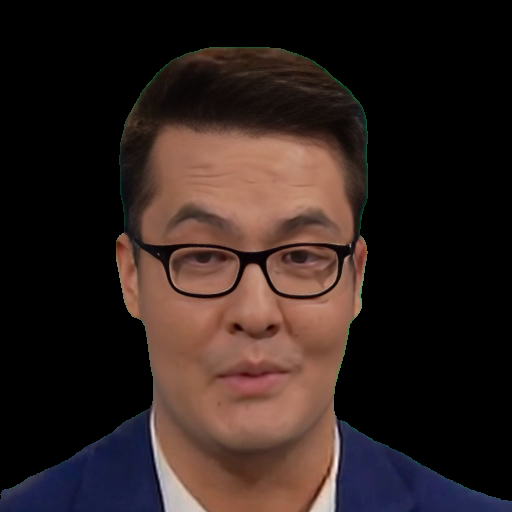

14
[115559, 64739, 17774, 8428, 21498, 9529, 1636, 8160, 1002, 1343, 2895, 2694, 2972, 2908]
0


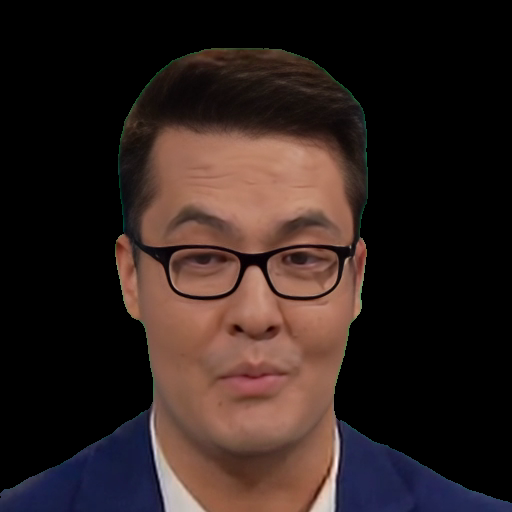

13
[64615, 115498, 17857, 8377, 21561, 9587, 1633, 8188, 1005, 2863, 1344, 2698, 2999]
0


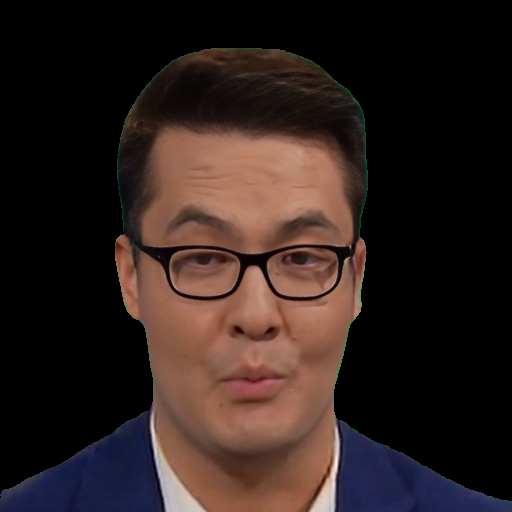

13
[115500, 64662, 17991, 8508, 21344, 9659, 1644, 8228, 1022, 1364, 2929, 2724, 3006]
0


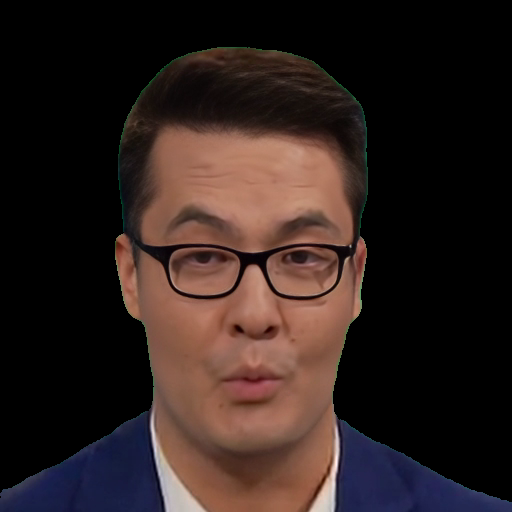

13
[64793, 115553, 18281, 8437, 20808, 9903, 1707, 8352, 1376, 1060, 2936, 2831, 2996]
0


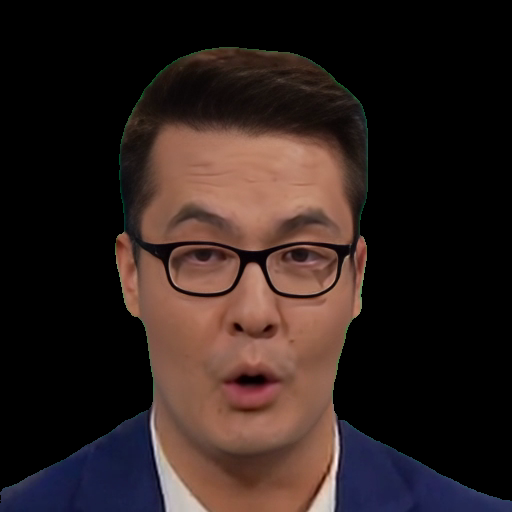

12
[64947, 115875, 8533, 18574, 20646, 10036, 1699, 8475, 2811, 1109, 2975, 3044]
0


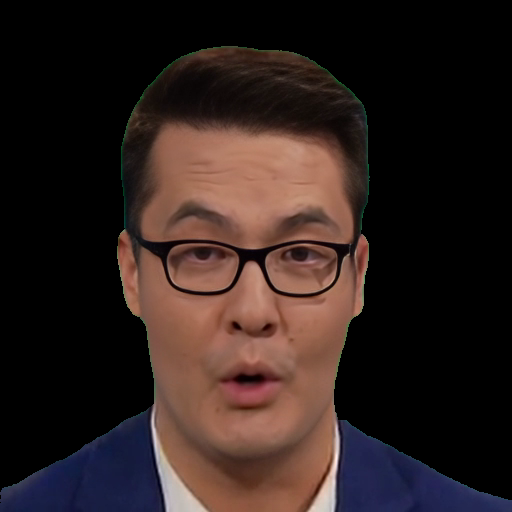

13
[116340, 65046, 8584, 18718, 20729, 10117, 1752, 8513, 1111, 2905, 2968, 8749, 3085]
0


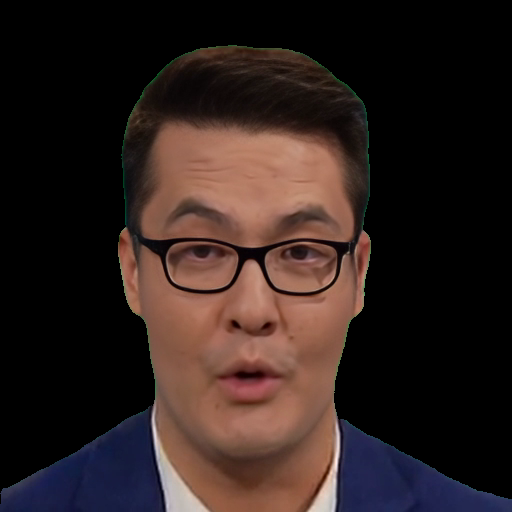

13
[116530, 65122, 8549, 18752, 20832, 10163, 1783, 8506, 1108, 2910, 2947, 3065, 8741]
0


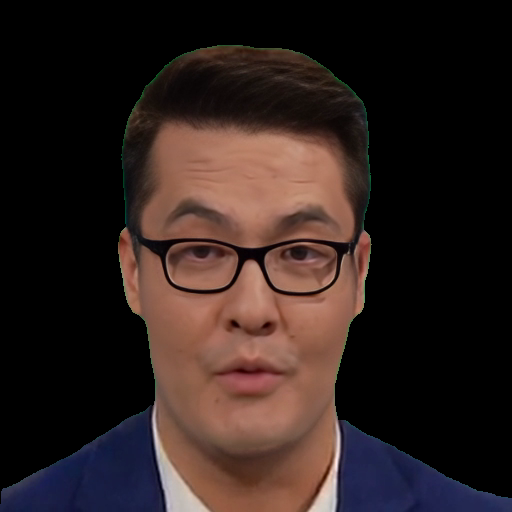

13
[116648, 64948, 18923, 8503, 20965, 10222, 1121, 8592, 1827, 2990, 1236, 2962, 3088]
0


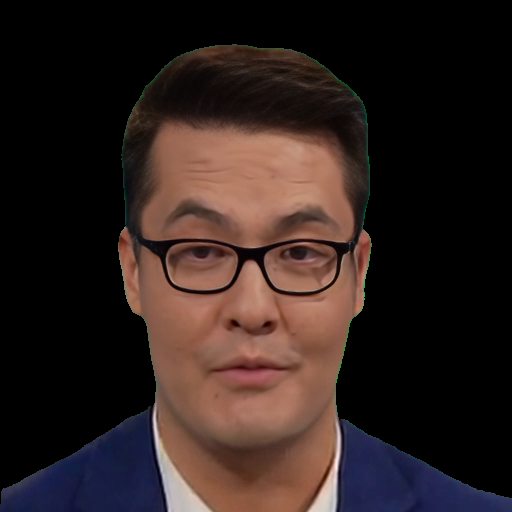

12
[116756, 65036, 8452, 19024, 20995, 10265, 1825, 1148, 8653, 3002, 2913, 3003]
0


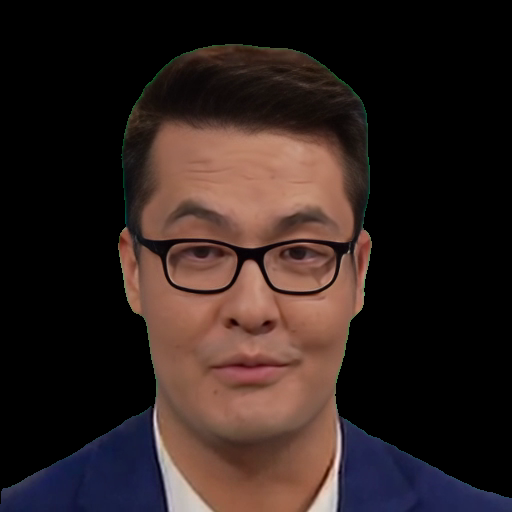

12
[65188, 116267, 8361, 18638, 20864, 10110, 1813, 8492, 1131, 2938, 2910, 2979]
0


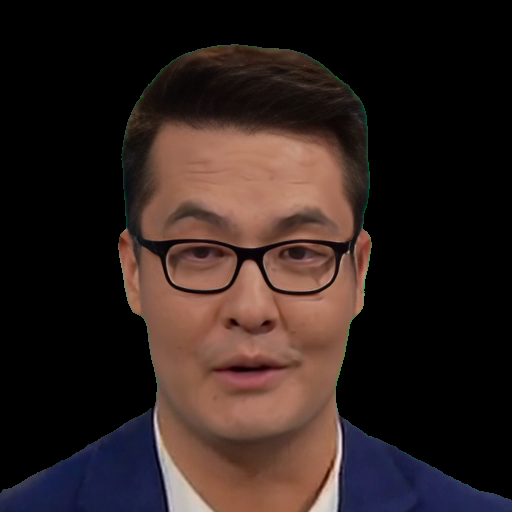

12
[65264, 115552, 8403, 18149, 20672, 1756, 9812, 8243, 1047, 2826, 2918, 3000]
0


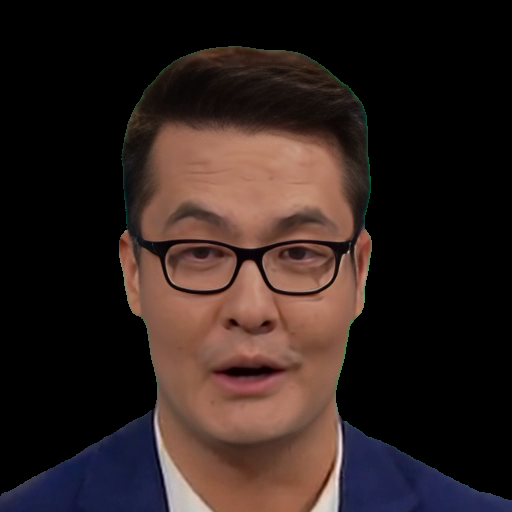

13
[65454, 115623, 8441, 18213, 20403, 1759, 9793, 8318, 1022, 2821, 2921, 1156, 3011]
0


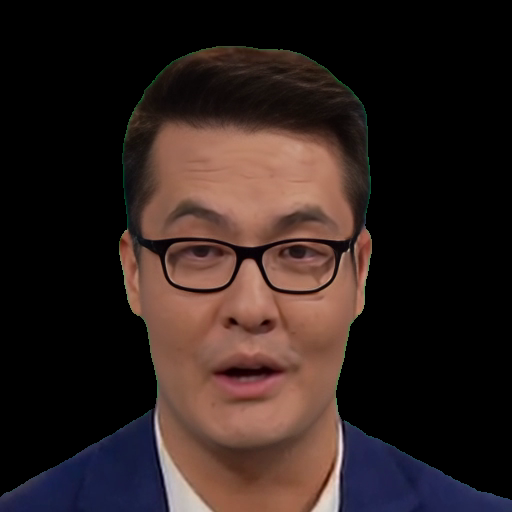

13
[65714, 114962, 8451, 17691, 20094, 1714, 9528, 8056, 1002, 2775, 2910, 3031, 8682]
0


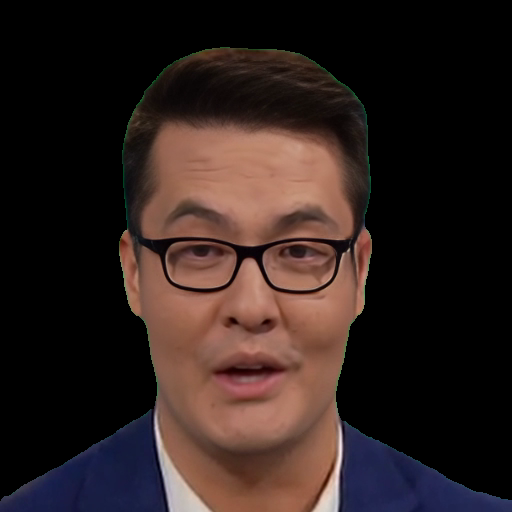

12
[115371, 65793, 8458, 17965, 20027, 1762, 9643, 8219, 1050, 2823, 2858, 3051]
0


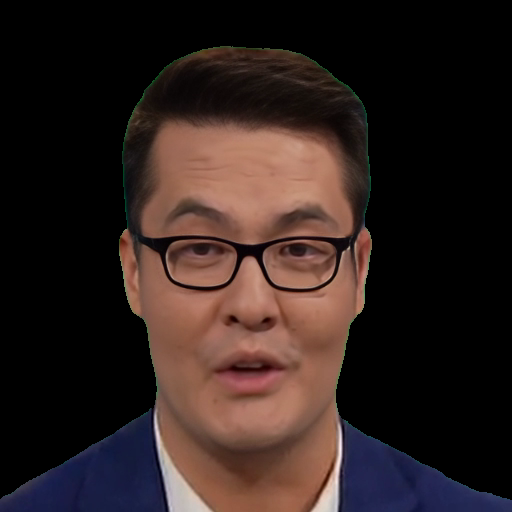

12
[115465, 65756, 8471, 18000, 20164, 9677, 1766, 8209, 1050, 2828, 2868, 3067]
0


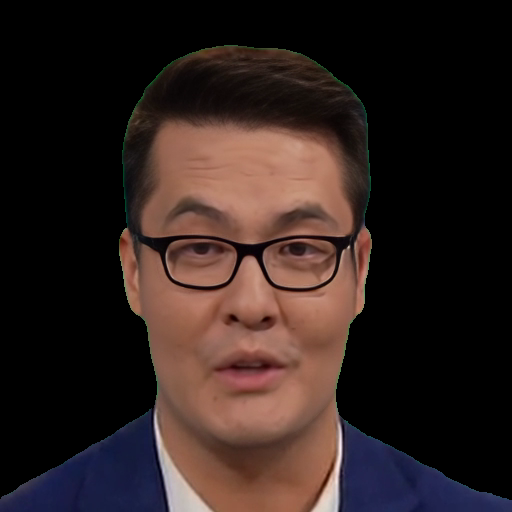

12
[115433, 65783, 8470, 17965, 20124, 1787, 9710, 8150, 1027, 2836, 2850, 3063]
0


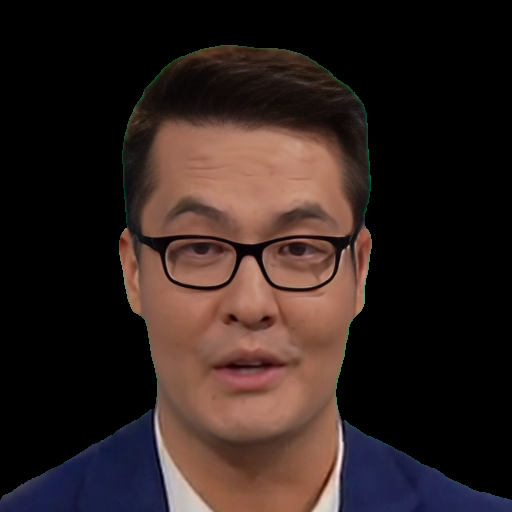

12
[115257, 65864, 8446, 17826, 20099, 1726, 9628, 8105, 1026, 2769, 2867, 3046]
0


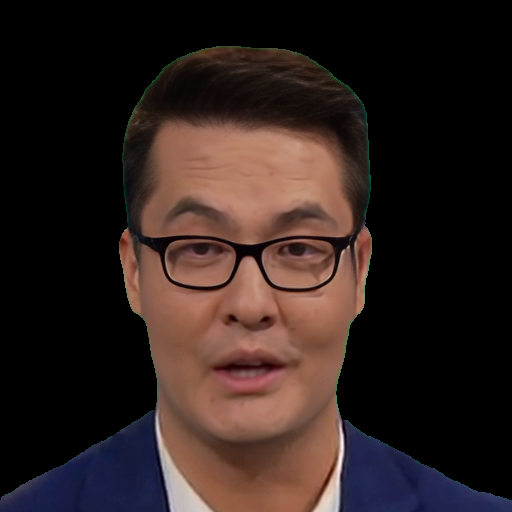

12
[115148, 65815, 8472, 17735, 20147, 1728, 9568, 8074, 1002, 2756, 2841, 3007]
0


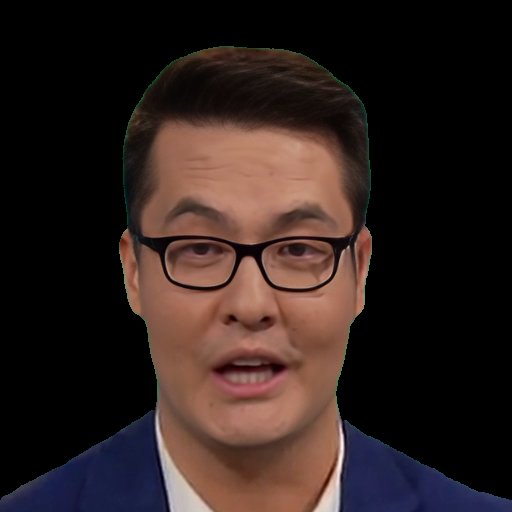

12
[115179, 65842, 17774, 8440, 20027, 9552, 1738, 8115, 1009, 2779, 2851, 3087]
0


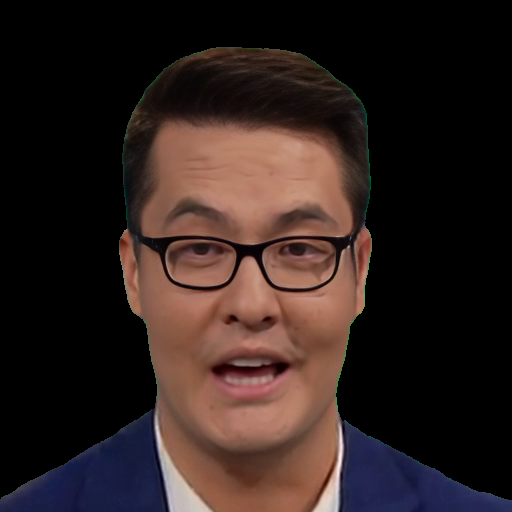

12
[115204, 65832, 8433, 17849, 19993, 9558, 1751, 8194, 1038, 2834, 2841, 3066]
0


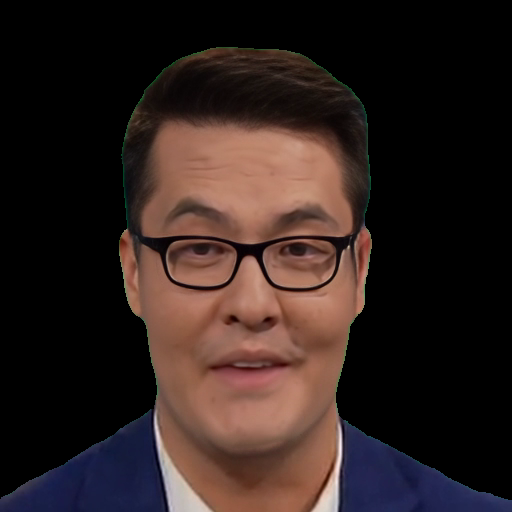

12
[115722, 65874, 8359, 18241, 19972, 9774, 1841, 8366, 1075, 2929, 2848, 3106]
0


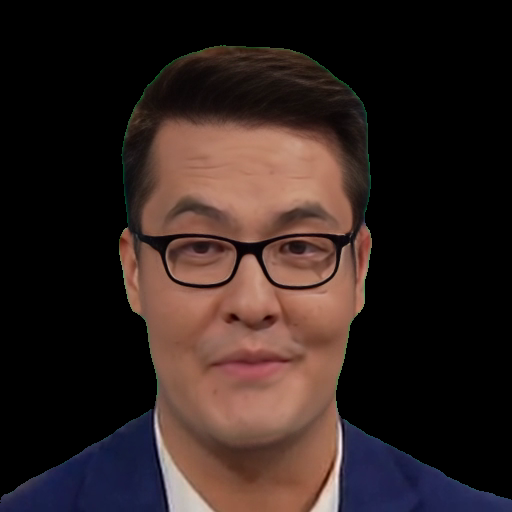

12
[65834, 115078, 8402, 17871, 19818, 9645, 1786, 8126, 1046, 2837, 3049, 2860]
0


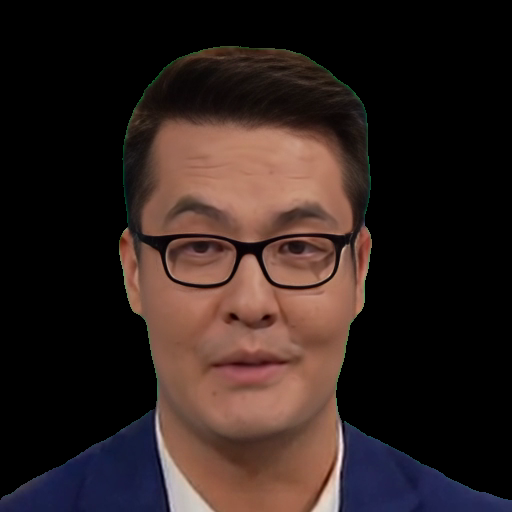

12
[114625, 65900, 8409, 17602, 19652, 9579, 1763, 7943, 1036, 2772, 2889, 3004]
0


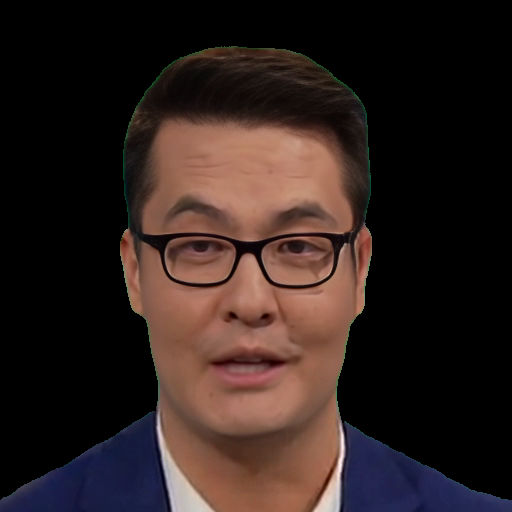

13
[66126, 114238, 8401, 17190, 19589, 1687, 9432, 7703, 1024, 1122, 2705, 2878, 3006]
0


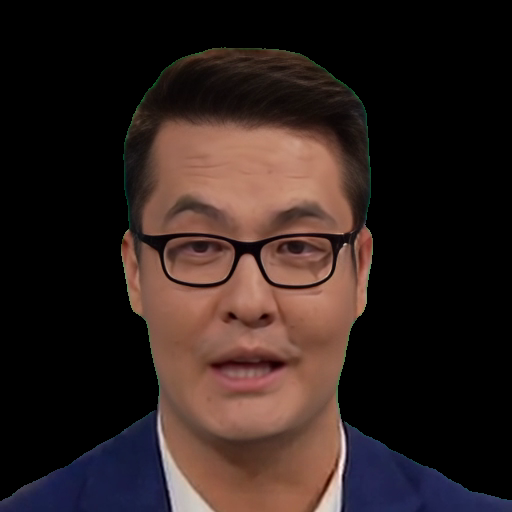

12
[114287, 66159, 8352, 17175, 19568, 1644, 9392, 7734, 1006, 2645, 2851, 3002]
0


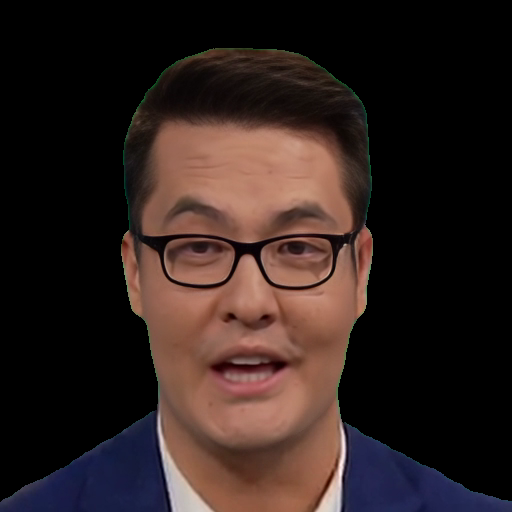

12
[115066, 66147, 8426, 17694, 19710, 1727, 9552, 8068, 1018, 2732, 3020, 2858]
0


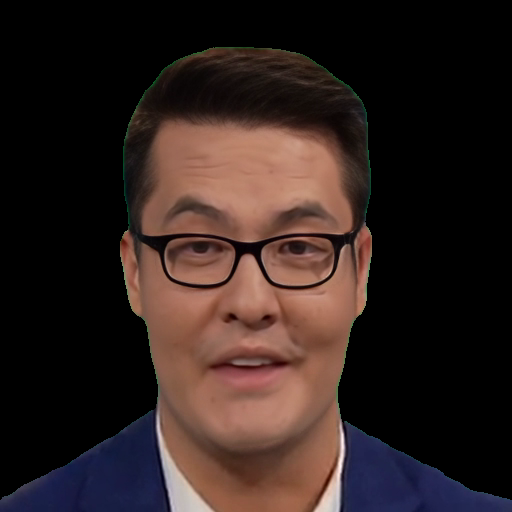

13
[115600, 66083, 17995, 8416, 19920, 1783, 9652, 8244, 1028, 2848, 282, 2902, 3083]
0


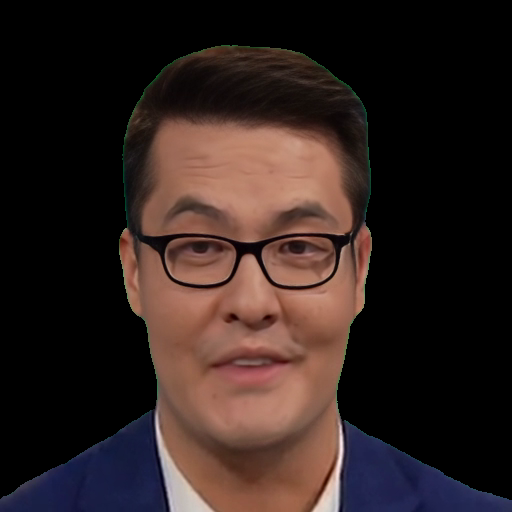

12
[115568, 65936, 8414, 18063, 20006, 9705, 1788, 8260, 1053, 2864, 3032, 2844]
0


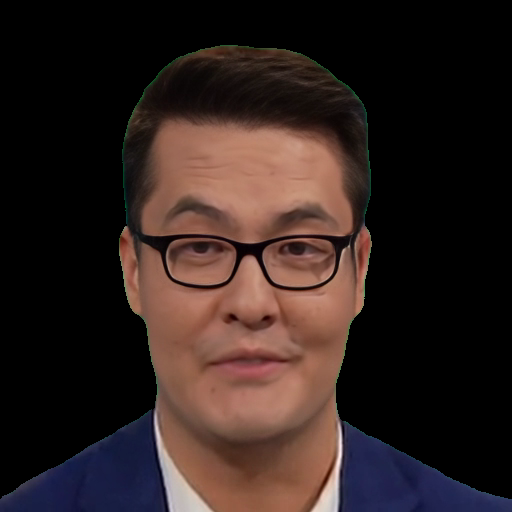

13
[115415, 65713, 8413, 17876, 20248, 9726, 1762, 8059, 8634, 1064, 2865, 2852, 3022]
0


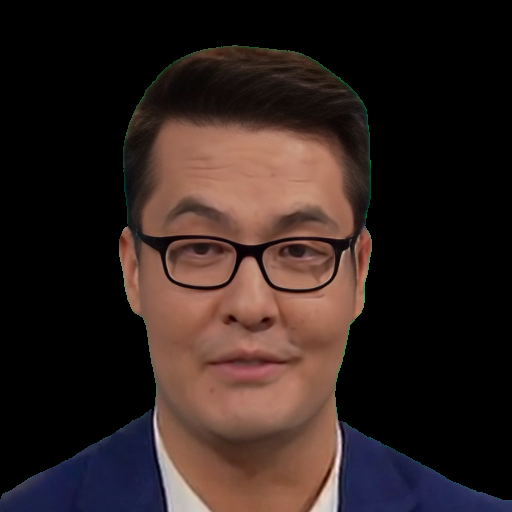

13
[65528, 114526, 8355, 17203, 20491, 9469, 1666, 7644, 996, 1214, 2689, 2895, 3006]
0


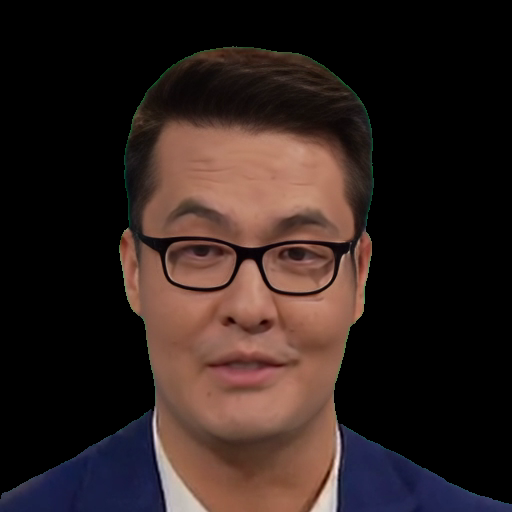

12
[114727, 65845, 8365, 17112, 20586, 9425, 1629, 7597, 994, 3003, 2648, 2904]
0


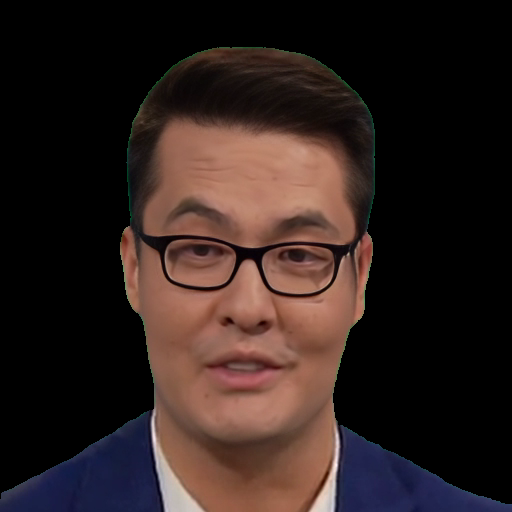

12
[114560, 65809, 8428, 16850, 20543, 9243, 1586, 7544, 961, 3029, 2837, 2597]
0


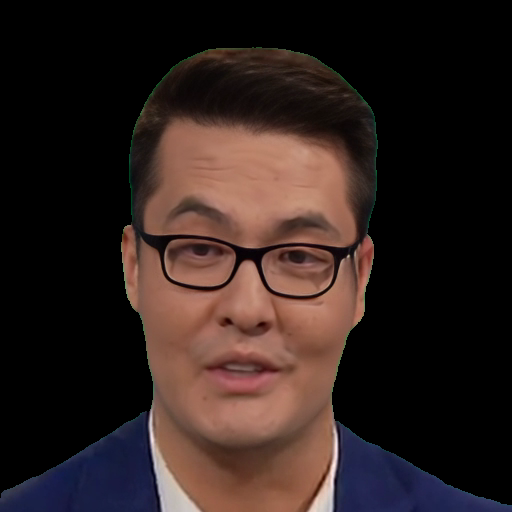

12
[65887, 114552, 8414, 16718, 20733, 9152, 7463, 927, 1597, 2512, 3064, 2901]
0


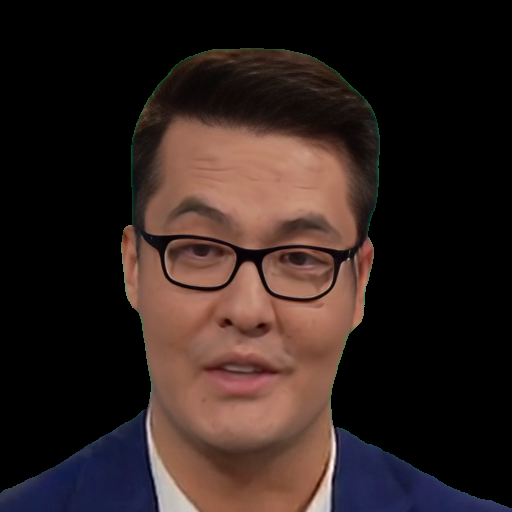

13
[65905, 114836, 8413, 16918, 20835, 9219, 949, 7602, 1609, 2649, 1239, 2919, 3051]
0


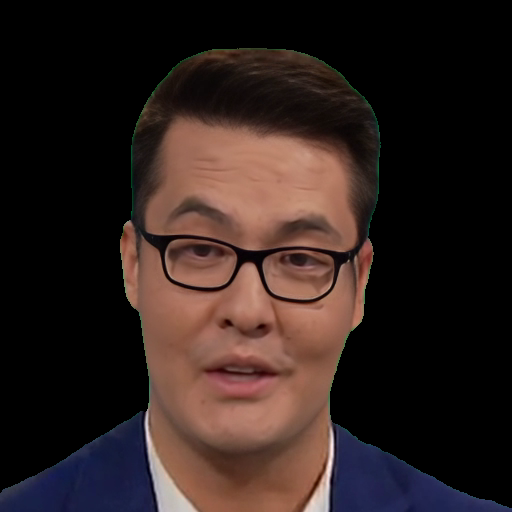

14
[65648, 115214, 8415, 17295, 21014, 9362, 980, 7848, 1642, 1295, 2642, 2941, 3065, 8603]
0


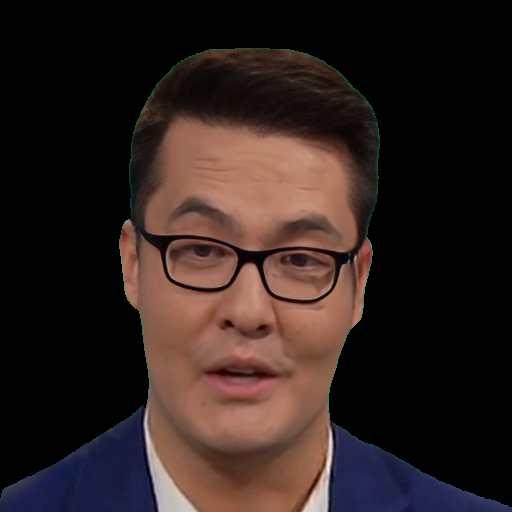

13
[65563, 115564, 8398, 17477, 21265, 9356, 1008, 8036, 1665, 1343, 2681, 2935, 3074]
0


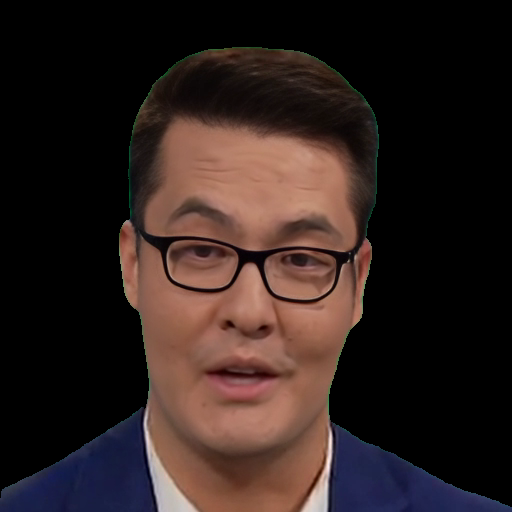

12
[65922, 115740, 8451, 17459, 21256, 9298, 990, 8096, 1625, 2899, 2634, 3094]
0


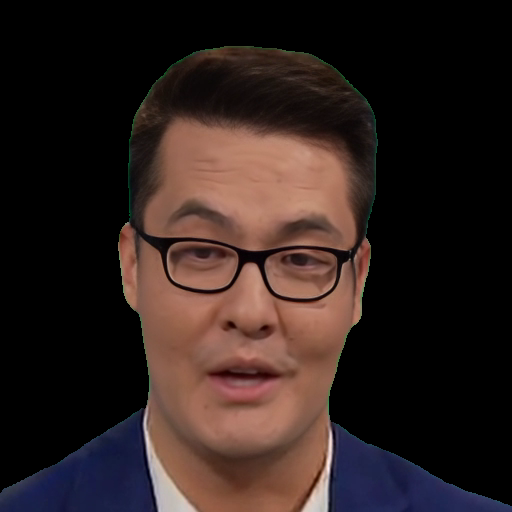

13
[115797, 66017, 8512, 17370, 21285, 9365, 948, 7935, 1572, 2852, 3037, 2542, 1304]
0


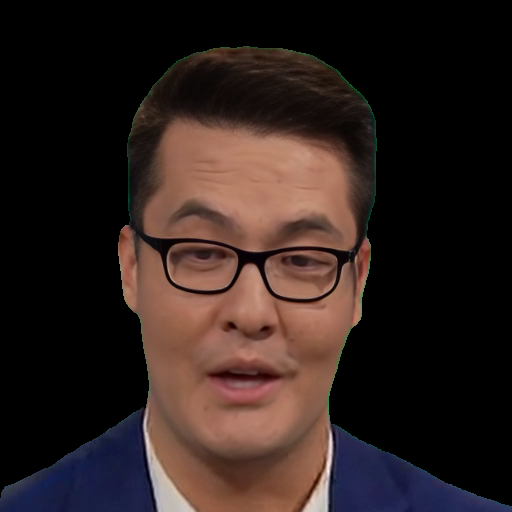

13
[115941, 66231, 8473, 17424, 21247, 9453, 926, 7893, 1568, 2875, 2984, 2510, 1304]
0


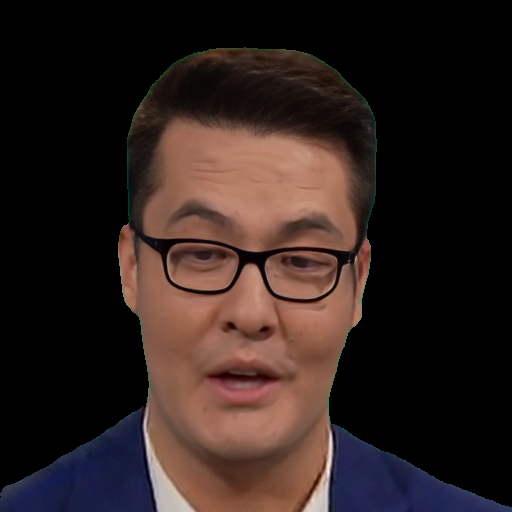

13
[115712, 66169, 8440, 17232, 21267, 9318, 914, 7834, 1547, 2870, 2964, 2480, 1317]
0


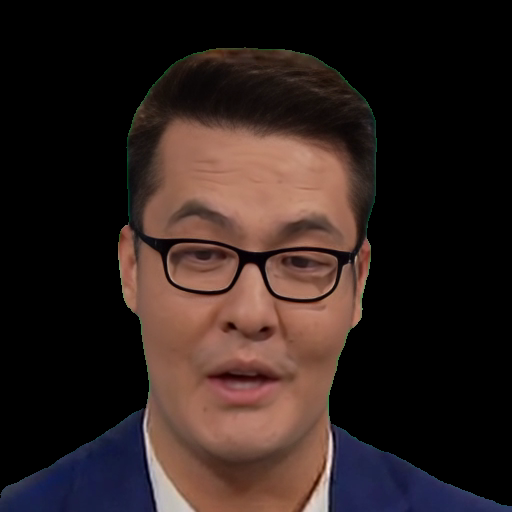

12
[114795, 65859, 8524, 16760, 21212, 9061, 898, 7603, 1522, 2869, 3072, 2428]
0


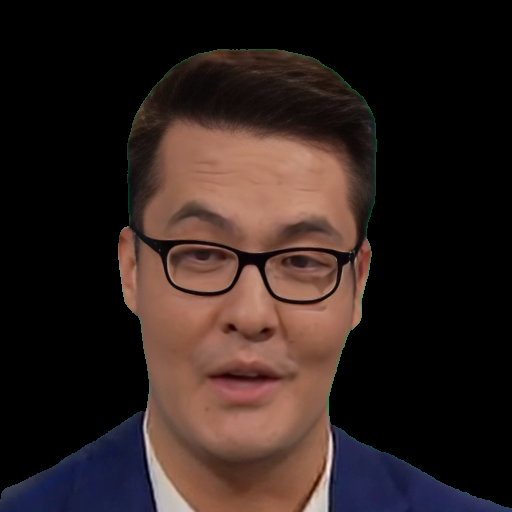

12
[114478, 65746, 8480, 16738, 21055, 9000, 923, 1547, 7653, 2849, 2485, 3142]
0


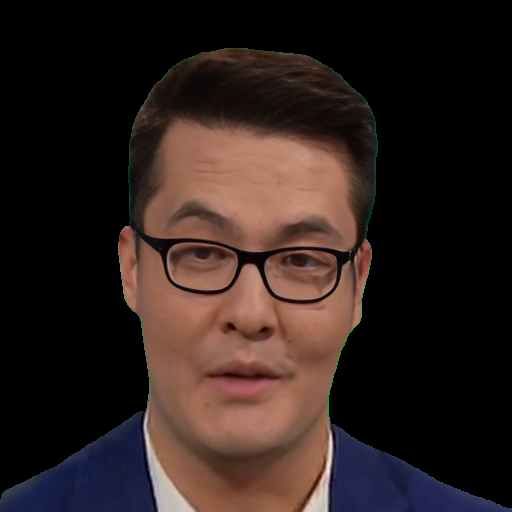

12
[65757, 114878, 8405, 17113, 20802, 9205, 960, 7810, 1626, 2601, 2874, 3144]
0


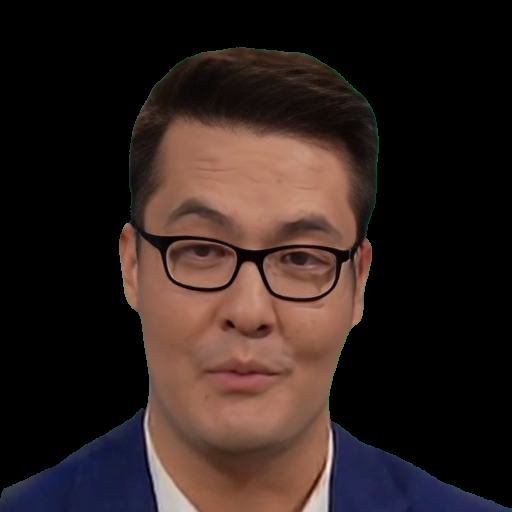

13
[65815, 114568, 8414, 17036, 20291, 9214, 997, 1635, 7723, 1238, 2781, 2646, 3114]
0


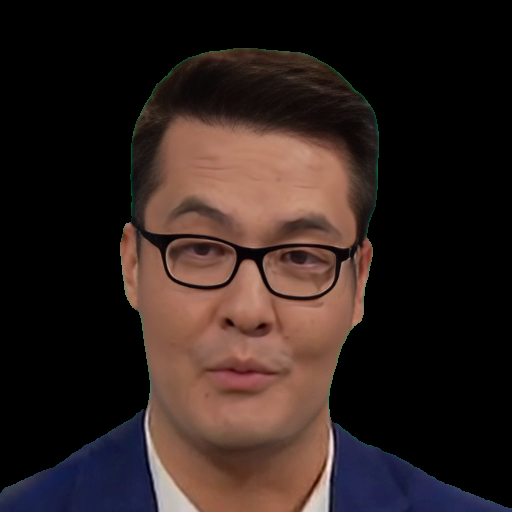

13
[65988, 114800, 8434, 17160, 20226, 9258, 991, 7801, 1652, 2806, 1241, 2661, 3130]
0


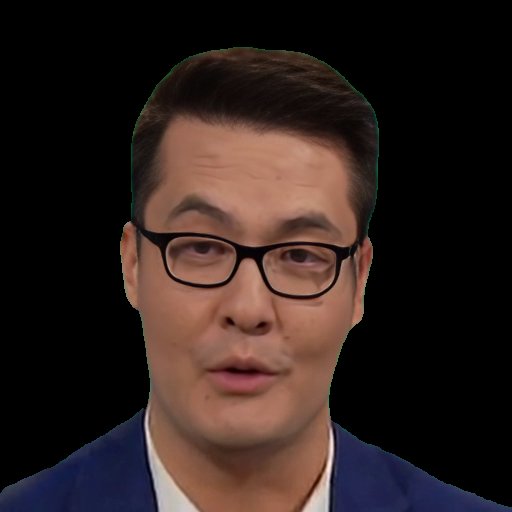

13
[66230, 114939, 8467, 17204, 20106, 9330, 987, 7793, 1659, 2809, 1264, 2665, 3134]
0


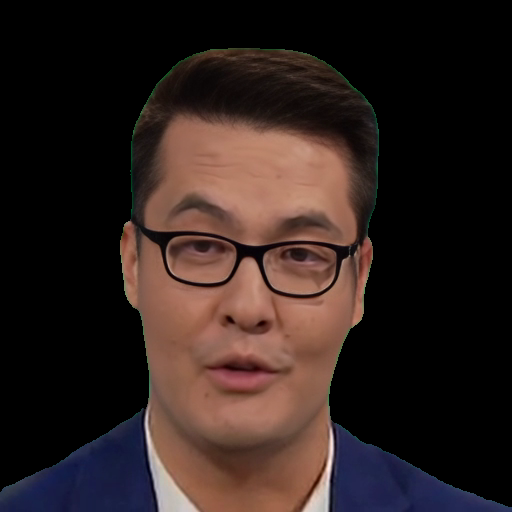

13
[66024, 114800, 8496, 17030, 20363, 9238, 971, 7690, 1642, 2642, 1260, 2834, 3154]
0


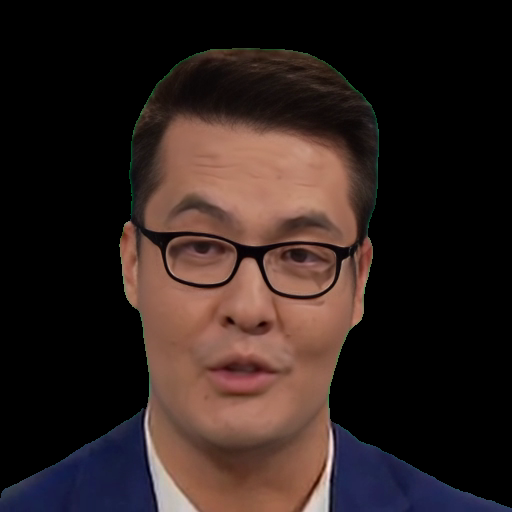

13
[65959, 114622, 8458, 16781, 20555, 9108, 957, 7557, 1618, 2600, 3112, 1287, 2828]
0


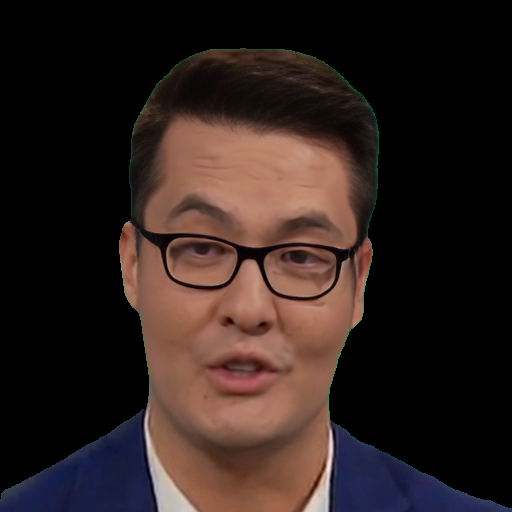

13
[65879, 115099, 8439, 17003, 20944, 9233, 973, 7670, 1632, 1309, 2633, 3079, 2894]
0


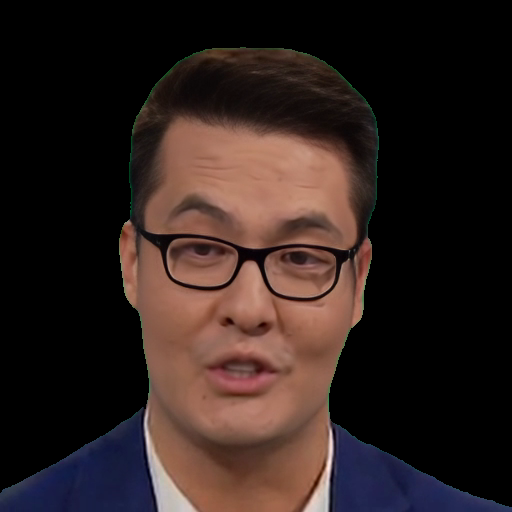

13
[65994, 115140, 8447, 16934, 21199, 9226, 955, 7611, 1602, 3082, 1322, 2887, 2568]
0


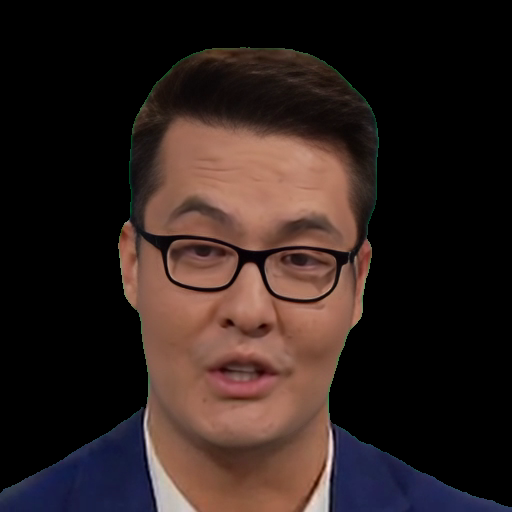

13
[66024, 115344, 8455, 17031, 21275, 9264, 7678, 945, 1601, 3046, 2911, 1326, 2552]
0


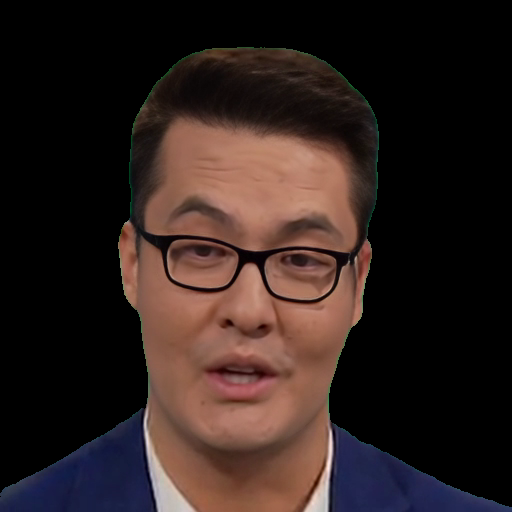

13
[66082, 115578, 8487, 17229, 21137, 9342, 955, 7801, 1628, 3057, 1350, 2602, 2929]
0


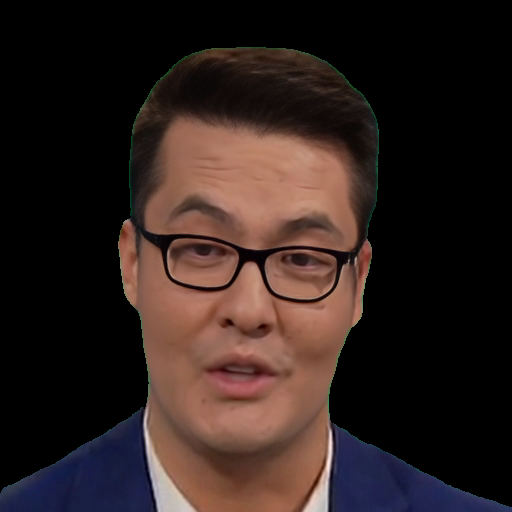

13
[65787, 115132, 8507, 17064, 21022, 9249, 958, 7731, 1601, 2566, 1318, 3127, 2937]
0


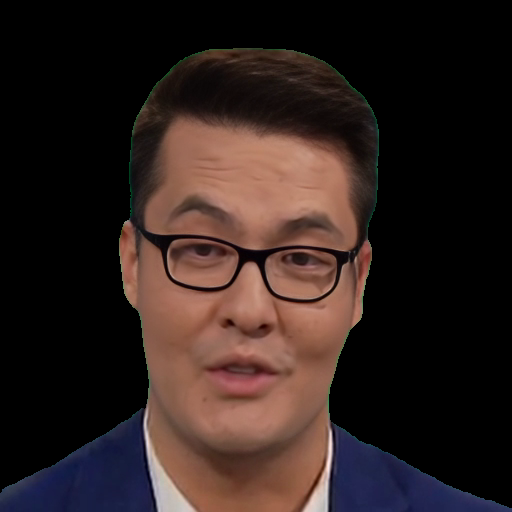

13
[65805, 115066, 8440, 17071, 20907, 9260, 961, 7724, 1607, 1319, 2575, 2908, 3122]
0


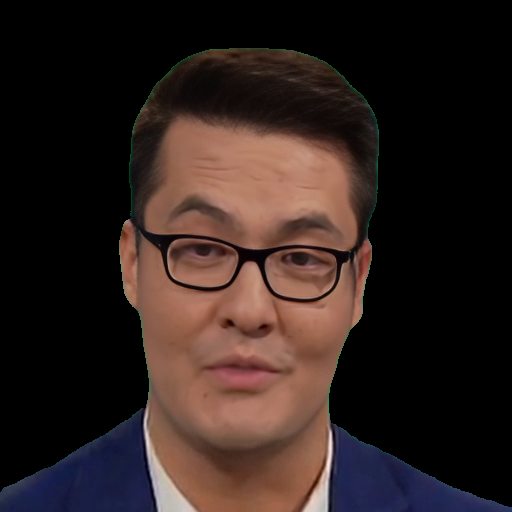

13
[65643, 114877, 8416, 17008, 21052, 9250, 955, 7686, 1604, 1318, 2565, 2890, 3071]
0


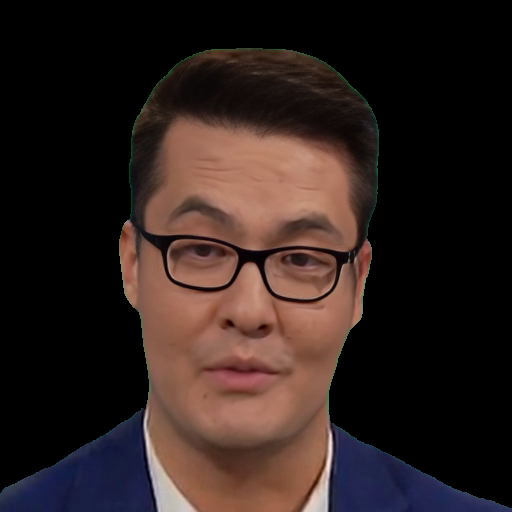

In [41]:
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image

cap = cv2.VideoCapture('/content/hvRvskYqSe_ee2167cfd7714afb8fc3373329a28816.mp4')
if not cap.isOpened():
    print("Error opening video file")

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('1659.mp4', fourcc, 30.0, (int(cap.get(3)), int(cap.get(4))))
i = 0
while cap.isOpened():
    ret, frame = cap.read()

    if ret:
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        new_frame = Image.fromarray(frame_rgb)
        outputs = generator(new_frame, points_per_batch=64)
        masks = outputs['masks']

        print(len(masks))
        sum_masks = [np.sum(i) for i in masks]
        print(sum_masks)
        ind = np.argmax(sum_masks)
        if np.sum(masks[ind][0:50, 0:50]) >10:
          masks[ind] = 1 - masks[ind]
        print(np.sum(masks[ind][0:50,0:50]))
        condition = np.stack((masks[ind],) * 3, axis=-1)
        output_image = condition * frame



        # output_image = remove(frame)

        # if output_image.shape[2] == 4:
        #     output_image = output_image[:, :, :3]

        cv2_imshow(output_image)

        # i += 1
        # if i == 2: break
        output_image_uint8 = output_image.astype(np.uint8)
        out.write(output_image_uint8)

        # out.write(output_image)

        if cv2.waitKey(25) & 0xFF == ord('q'):
            break
    else:
        break

cap.release()
out.release()

cv2.destroyAllWindows()
